In [1]:
library(IRdisplay)
display_html("<style>.container { width:100% !important; }</style>")

.libPaths()

[1] "/hps/software/users/marioni/Leah/miniconda3/envs/basic_renv/lib/R/library"

# Trunk Like Structure Data
https://www.science.org/doi/full/10.1126/science.aba4937#

In [2]:
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(purrr))
suppressPackageStartupMessages(library(Seurat))
suppressPackageStartupMessages(library(assertthat))
suppressPackageStartupMessages(library(optparse))
suppressPackageStartupMessages(library(scran))
suppressPackageStartupMessages(library(scds))
suppressPackageStartupMessages(library(dplyr))
suppressPackageStartupMessages(library(gprofiler2))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(gridExtra))
suppressPackageStartupMessages(library(viridis))
source("/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/plotting_settings.R")

In [3]:
# the order in which I plot the clusters
cluster_order <- c("PCGLC", "Early PS", "Inactive PS", "Late PS",
                   "Early Mesp1 Mesoderm", "Late Mesp1 Mesoderm", "Early Head Mesoderm", "Late Head Mesoderm",
                   "Early NMP-independent Meso", "Mid NMP-independent Meso", "Late NMP-independent Meso",
                   "Somite", "Mature Somites 1", "Somite0", "Somite-1", "Mature Somites 2", "SomiteSclero", "SomiteDermo",
                   "Pharyngeal Mesoderm?", "Endothelium", "Endothelial",
                   "aPSM","pPSM", "NMP-derived Meso", "NMP", "NMPs", "NMP-derived Neural", "Spinal Cord", "NeuralTube1", "NeuralTube2",
                   "Caudal Epiblast", "Early NMP-independent Neural", "Late NMP-independent Neural", "Separate FMH",
                   "Early Endoderm", "Node", "Mature Endoderm", "Endoderm", "Endoderm1", "Endoderm2",
                   "Unknown"
                  )

# my de novo gastruloid cluster colours
cluster_colours = c(
    "Endoderm1" = "#F397C0",
    "Endoderm2" = "#EF5A9D",
    "Node" = "#F397C0",
    'Somite0' = "#8DB5CE",
    'SomiteSclero' = "yellow",
    'Endothelial' = "#ff891c",
    'Endoderm' = "#EF5A9D",
    'PCGLC' = "#FACB12",
    'Unknown' = "red",
    'aPSM' = "turquoise",
    'Somite' = "#006f9e",
    'NMPs' = "#8EC792",
    'Somite-1' = "#00405c",
    'NeuralTube2' = "#CDE088",
    'pPSM' = "#67ffb1",
    'SomiteDermo' = "brown",
    'NeuralTube1' = "#aed48d",
    "Early Endoderm" = "#F397C0",
    "Endothelium" = "#ff891c",
    "Mature Endoderm" = "#EF5A9D",
    "Inactive PS" = "#FACB12",
    "Late PS" = "#c19f70",
    "Early PS" = "#DABE99",
    "Early NMP-independent Neural" = "#65A83E",
    "Late NMP-independent Neural" = "#647a4f",
    "Spinal Cord" = "#CDE088",
    "NMP" = "#8EC792",
    "Caudal Epiblast" = "#9e6762",
    "Separate FMH" = "#414f33",
    "NMP-derived Neural" = "#aed48d",
    "NMP-derived Meso" = "#67ffb1",
    "Early Mesp1 Mesoderm" = "#DFCDE4",
    "Late Mesp1 Mesoderm" = "#C594BF",
    "Pharyngeal Mesoderm?" = "#C9EBFB",
    "Early Head Mesoderm" = "#007800",
    "Late Head Mesoderm" = "#004600",
    "Mature Somites 1" = "#006f9e",
    "Mature Somites 2" = "#00405c",
    "Late NMP-independent Meso" = "#8DB5CE",
    "Early NMP-independent Meso" = "blue",
    "Mid NMP-independent Meso" = "turquoise"
)

# Load Data

In [4]:
# Load Data
d4_TLS <- Read10X(data.dir = '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/TLS/GSM4196547_TLS_96h/filtered_feature_bc_matrix/', gene.column = 1)
d45_TLS <- Read10X(data.dir = '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/TLS/GSM4196548_TLS_108h/filtered_feature_bc_matrix/', gene.column = 1)
d5_TLS <- Read10X(data.dir = '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/TLS/GSM4196549_TLS_120h/filtered_feature_bc_matrix/', gene.column = 1)
d5_gastruloid <- Read10X(data.dir = '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/gastruloid/GSM4478171_Gastruloid_120h/filtered_feature_bc_matrix/', gene.column = 1)
d5_TLSCL <- Read10X(data.dir = '/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/TLSCL/GSM4478172_TLSMGCL_120h/filtered_feature_bc_matrix/', gene.column = 1)

metadata_TLS <- read.table(file = "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/other_data/veenvliet/TLS_meta_data.tsv", header = T, sep = "\t")
metadata_TLS <- as.data.table(metadata_TLS)
metadata_TLS$batch <- metadata_TLS$TP
metadata_TLS$organoid <- 'TLS'
metadata_TLS$dataset <- 'veenvliet'
metadata_TLS[,barcode := paste0(BC, '-1')]
metadata_TLS[TP=='TLS_96h', cell := paste0('cell_', 1:sum(metadata_TLS$TP=='TLS_96h'), '_TLS_96h')]
metadata_TLS[TP=='TLS_108h', cell := paste0('cell_', 1:sum(metadata_TLS$TP=='TLS_108h'), '_TLS_108h')]
metadata_TLS[TP=='TLS_120h', cell := paste0('cell_', 1:sum(metadata_TLS$TP=='TLS_120h'), '_TLS_120h')]
metadata_TLS[TP=='TLS_96h', timepoint := 'd4']
metadata_TLS[TP=='TLS_108h', timepoint := 'd4.5']
metadata_TLS[TP=='TLS_120h', timepoint := 'd5']

metadata_gastr <- data.table(barcode = colnames(d5_gastruloid), timepoint='d5', batch='Gastruloid_120h', cell=paste0('cell_', 1:ncol(d5_gastruloid), '_Gastruloid_120h'), organoid="gastr", dataset="veenvliet")
metadata_TLSCL <- data.table(barcode = colnames(d5_TLSCL), timepoint='d5', batch='TLSCL_120h', cell=paste0('cell_', 1:ncol(d5_TLSCL), '_TLSCL_120h'), organoid="TLSCL", dataset="veenvliet")

metadata <- rbindlist(list(metadata_TLS, metadata_gastr, metadata_TLSCL), fill=TRUE)

d4_TLS <- d4_TLS[,metadata_TLS[timepoint=='d4']$barcode]
colnames(d4_TLS) <- metadata_TLS[timepoint=='d4']$cell
d45_TLS <- d45_TLS[,metadata_TLS[timepoint=='d4.5']$barcode]
colnames(d45_TLS) <- metadata_TLS[timepoint=='d4.5']$cell
d5_TLS <- d5_TLS[,metadata_TLS[timepoint=='d5']$barcode]
colnames(d5_TLS) <- metadata_TLS[timepoint=='d5']$cell
d5_gastruloid <- d5_gastruloid[,metadata_gastr$barcode]
colnames(d5_gastruloid) <- metadata_gastr$cell
d5_TLSCL <- d5_TLSCL[,metadata_TLSCL$barcode]
colnames(d5_TLSCL) <- metadata_TLSCL$cell

counts <- Reduce(cbind, list(d4_TLS, d45_TLS, d5_TLS, d5_gastruloid, d5_TLSCL))
counts <- counts[,metadata$cell]

rownames(metadata) <- metadata$cell

# Create Seurat

In [5]:
genemeta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/gene_metadata_atlas_gastr_hvgs.txt.gz')
counts <- counts[(rownames(counts) %in% genemeta$ens_id),]
genemeta <- genemeta[match(rownames(counts), genemeta$ens_id),]
rownames(genemeta) <- genemeta$ens_id
srat_veenvliet <- CreateSeuratObject(counts = counts, project = "Trunk-Like Structures", meta.data = metadata)
srat_veenvliet[["RNA"]] <- AddMetaData(
    object = srat_veenvliet[["RNA"]],
    metadata = genemeta
)


# QC

In [6]:
mito.genes <- srat_veenvliet@assays$RNA@meta.features$ens_id[grepl(pattern = "^mt-", x = srat_veenvliet@assays$RNA@meta.features$symbol)]
srat_veenvliet[["percent.mt"]] <- PercentageFeatureSet(srat_veenvliet, features = mito.genes)
ribo.genes <- srat_veenvliet@assays$RNA@meta.features$ens_id[grepl(pattern = "^Rpl", x = srat_veenvliet@assays$RNA@meta.features$symbol) | grepl(pattern = "^Rps", x = srat_veenvliet@assays$RNA@meta.features$symbol)]
srat_veenvliet[["percent.ribo"]] <- PercentageFeatureSet(srat_veenvliet, features = ribo.genes)

md <- as.data.table(srat_veenvliet@meta.data)

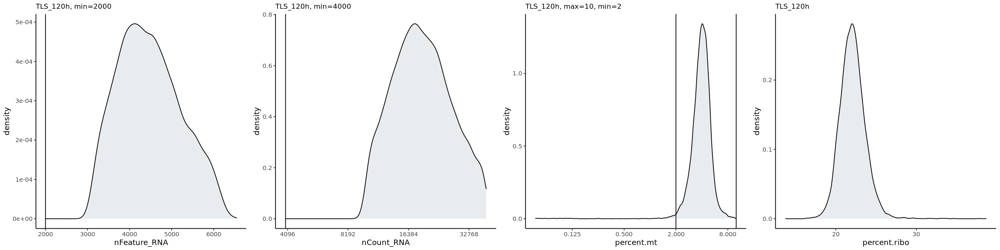

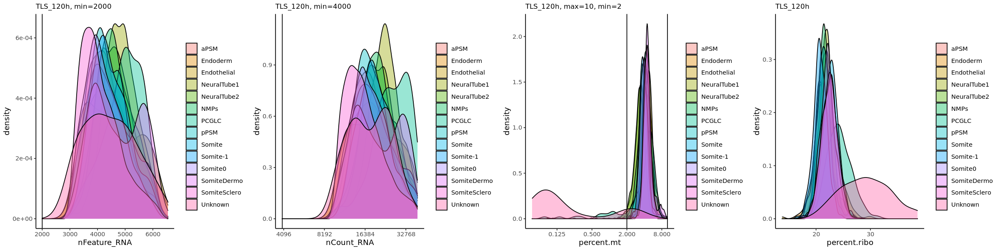

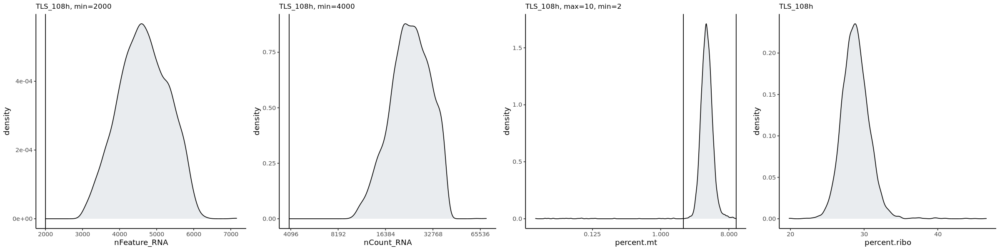

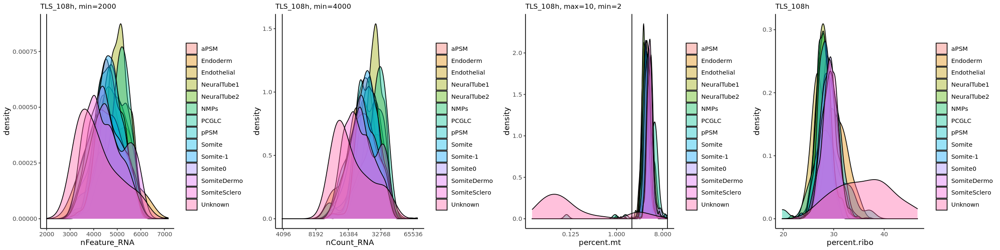

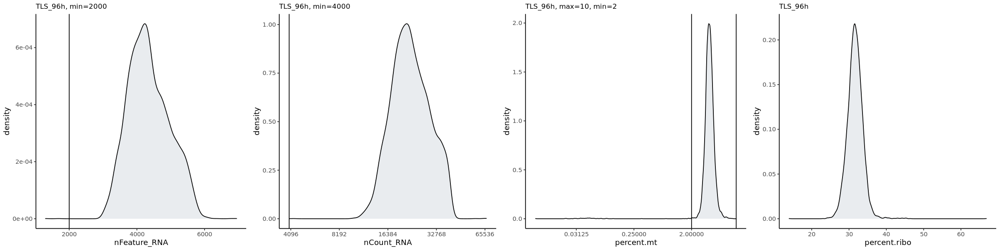

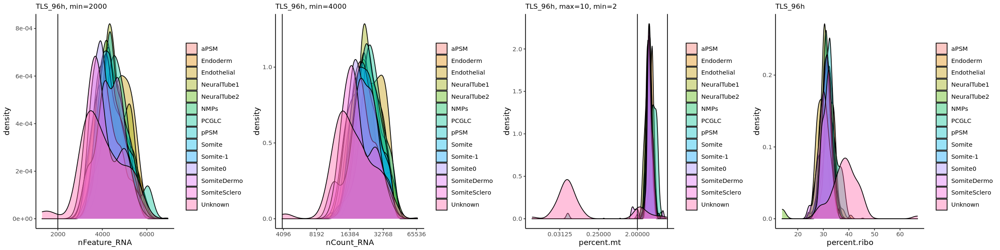

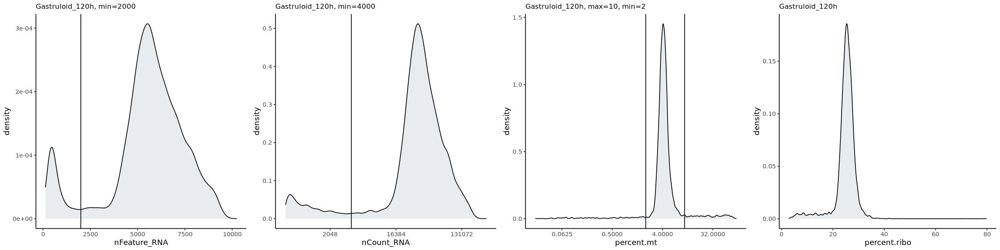

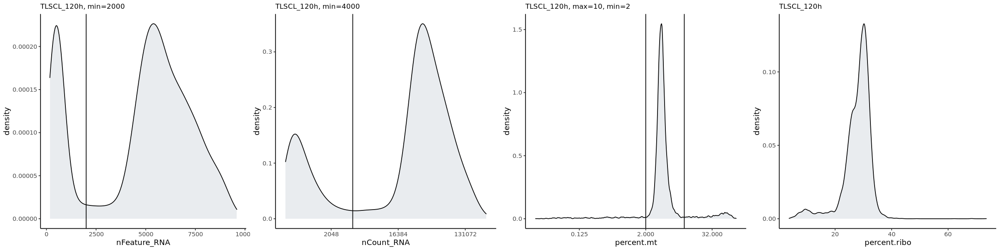

In [7]:
options(repr.plot.width=20, repr.plot.height=5)
options(warn=-1)

io <- list()
io$min_nFeature_RNA <- 2000
io$min_nCount_RNA <- 4000
io$max_percent.mt <- 10
io$min_percent.mt <- 2

for (b in unique(md$batch)) {
    
    bi <- strsplit(b,"_")[[1]] %>% .[length(.)]

    toplot <- md[batch==b]

    p1 <- (ggplot(toplot, aes(x=nFeature_RNA)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        #scale_fill_manual(values=c("#69b3a2")) +
        labs(fill="") +
        geom_vline(xintercept=io$min_nFeature_RNA) +
        ggtitle(paste0(b, ", min=", io$min_nFeature_RNA)) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p2 <- (ggplot(toplot, aes(x=nCount_RNA)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        scale_x_continuous(trans='log2') +
        geom_vline(xintercept=io$min_nCount_RNA) +
        ggtitle(paste0(b, ", min=", io$min_nCount_RNA)) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p3 <- (ggplot(toplot, aes(x=percent.mt)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        scale_x_continuous(trans='log2') +
        geom_vline(xintercept=io$max_percent.mt) +
        geom_vline(xintercept=io$min_percent.mt) +
        ggtitle(paste0(b, ", max=", io$max_percent.mt, ", min=", io$min_percent.mt)) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    p4 <- (ggplot(toplot, aes(x=percent.ribo)) +
        geom_density(fill="#e9ecef", position = 'identity') +
        labs(fill="") +
        ggtitle(b) +
        theme_classic() +
        theme(plot.title = element_text(size = 10)))

    grid.arrange(p1, p2, p3, p4, ncol=4)
    
    if (length(unique(toplot$cell_state)) > 1) {

        p1 <- (ggplot(toplot, aes(x=nFeature_RNA, fill=cell_state)) +
            geom_density(alpha=0.4, position = 'identity') +
            #scale_fill_manual(values=c("#69b3a2")) +
            labs(fill="") +
            geom_vline(xintercept=io$min_nFeature_RNA) +
            ggtitle(paste0(b, ", min=", io$min_nFeature_RNA)) +
            theme_classic() +
            theme(plot.title = element_text(size = 10)))

        p2 <- (ggplot(toplot, aes(x=nCount_RNA, fill=cell_state)) +
            geom_density(alpha=0.4, position = 'identity') +
            labs(fill="") +
            scale_x_continuous(trans='log2') +
            geom_vline(xintercept=io$min_nCount_RNA) +
            ggtitle(paste0(b, ", min=", io$min_nCount_RNA)) +
            theme_classic() +
            theme(plot.title = element_text(size = 10)))

        p3 <- (ggplot(toplot, aes(x=percent.mt, fill=cell_state)) +
            geom_density(alpha=0.4, position = 'identity') +
            labs(fill="") +
            scale_x_continuous(trans='log2') +
            geom_vline(xintercept=io$max_percent.mt) +
            geom_vline(xintercept=io$min_percent.mt) +
            ggtitle(paste0(b, ", max=", io$max_percent.mt, ", min=", io$min_percent.mt)) +
            theme_classic() +
            theme(plot.title = element_text(size = 10)))

        p4 <- (ggplot(toplot, aes(x=percent.ribo, fill=cell_state)) +
            geom_density(alpha=0.4, position = 'identity') +
            labs(fill="") +
            ggtitle(b) +
            theme_classic() +
            theme(plot.title = element_text(size = 10)))

        grid.arrange(p1, p2, p3, p4, ncol=4)
        
    }

}
options(warn=0)

Warning message:
“Transformation introduced infinite values in discrete y-axis”
Warning message:
“Removed 16354 rows containing missing values (geom_point).”
Warning message:
“Removed 16354 rows containing missing values (geom_point).”


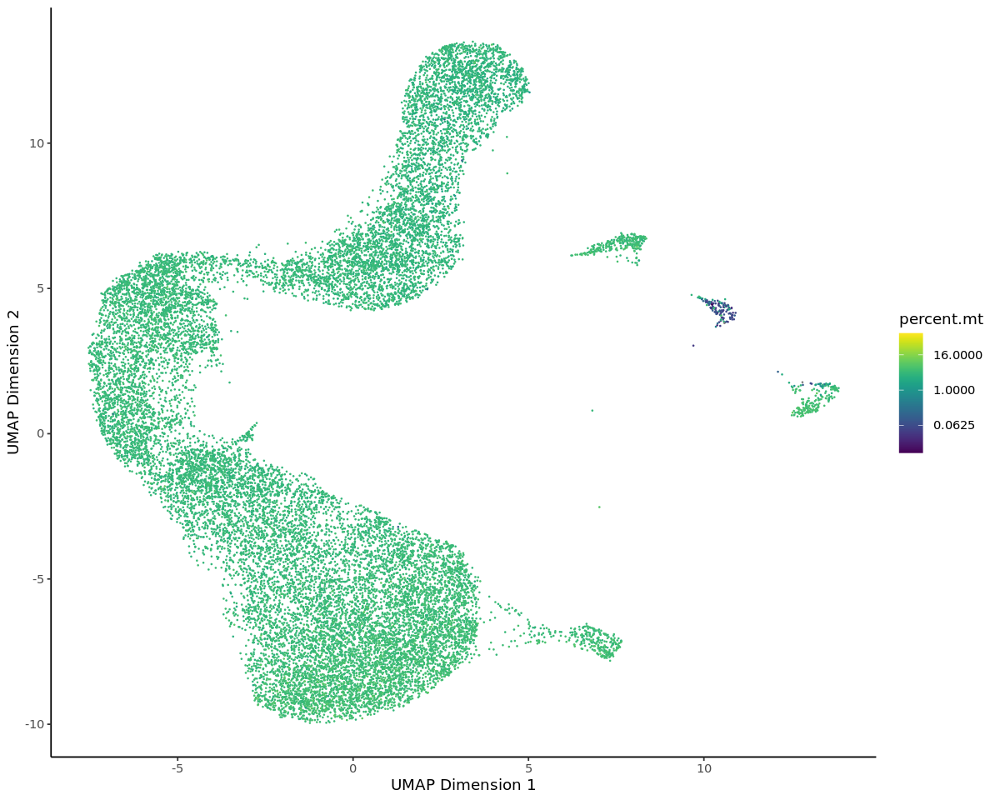

Warning message:
“Removed 16354 rows containing missing values (geom_point).”


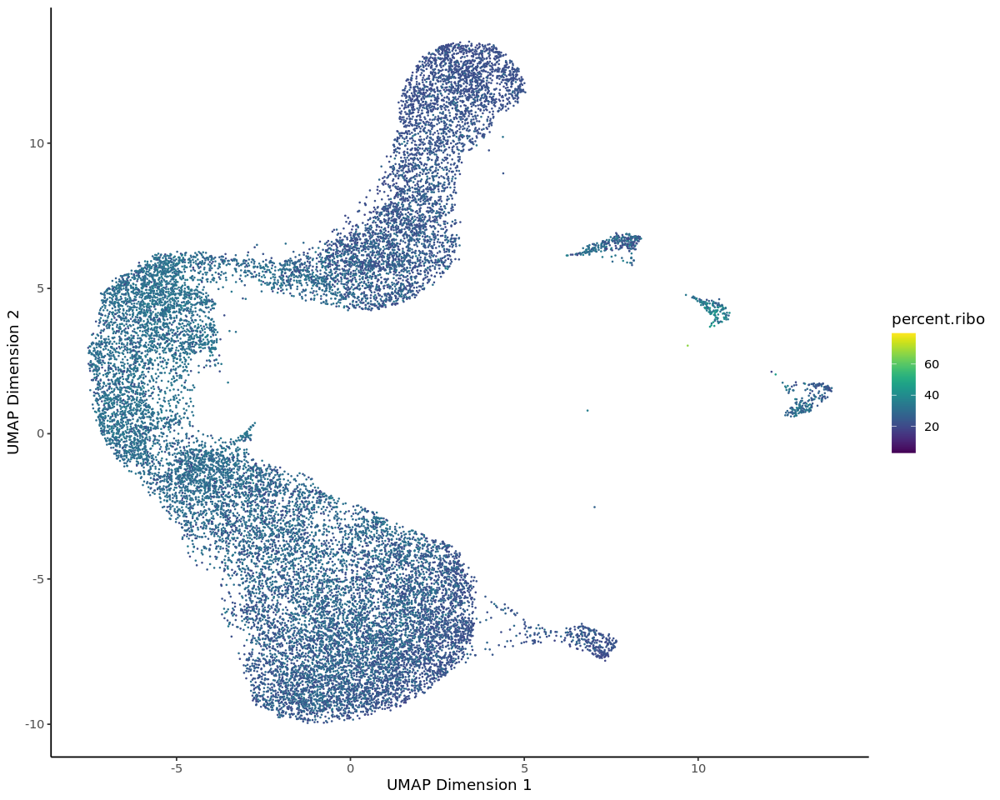

Warning message:
“Removed 16354 rows containing missing values (geom_point).”


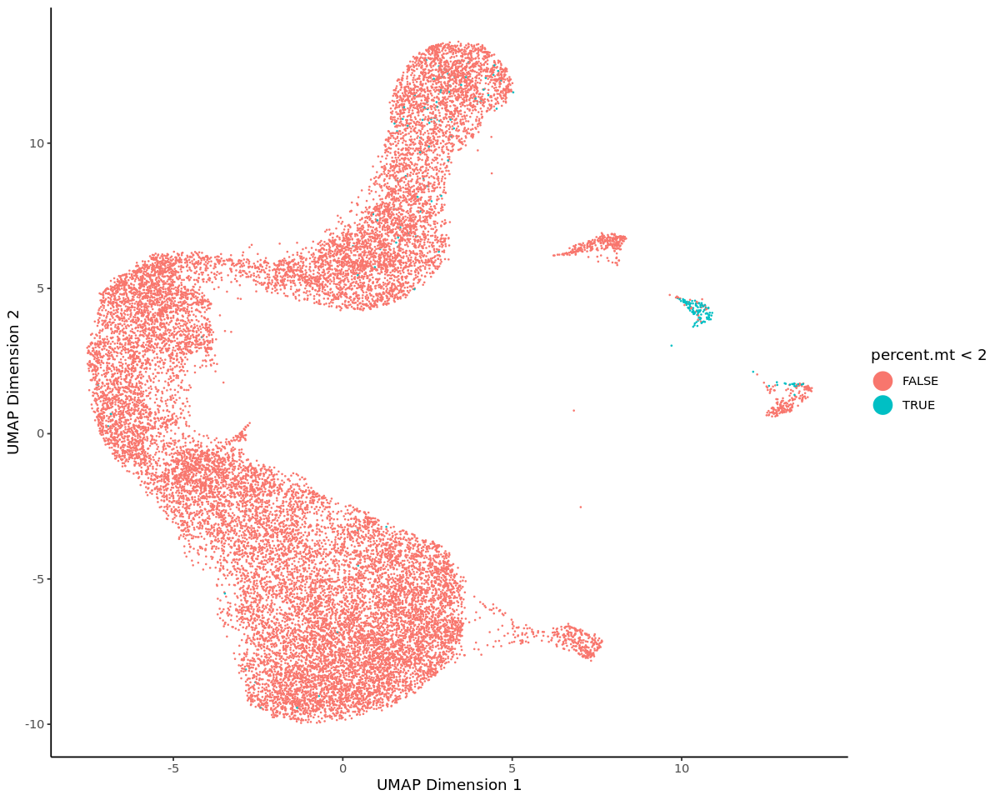

Warning message:
“Removed 16354 rows containing missing values (geom_point).”


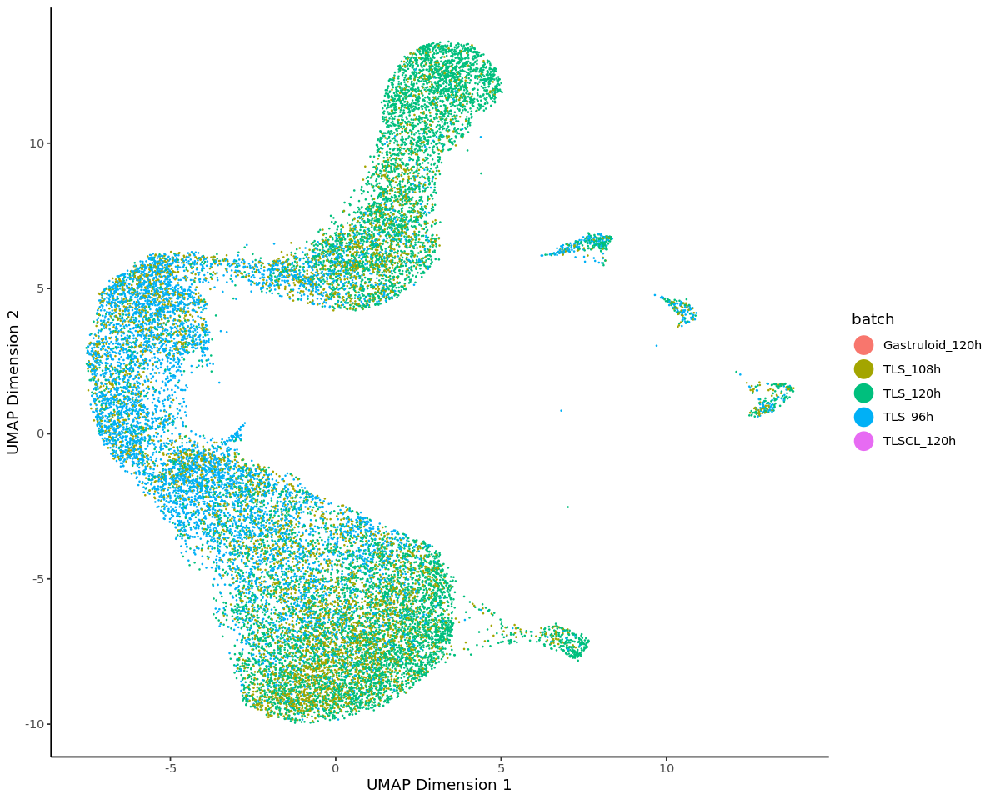

Warning message:
“Removed 16354 rows containing missing values (geom_point).”


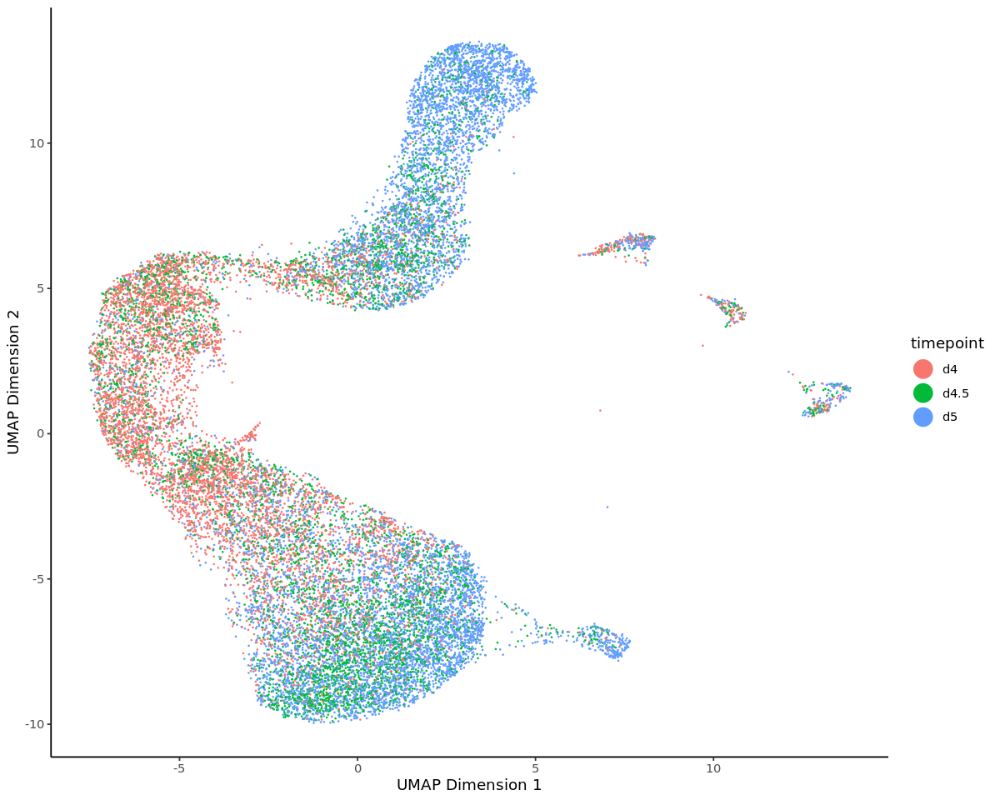

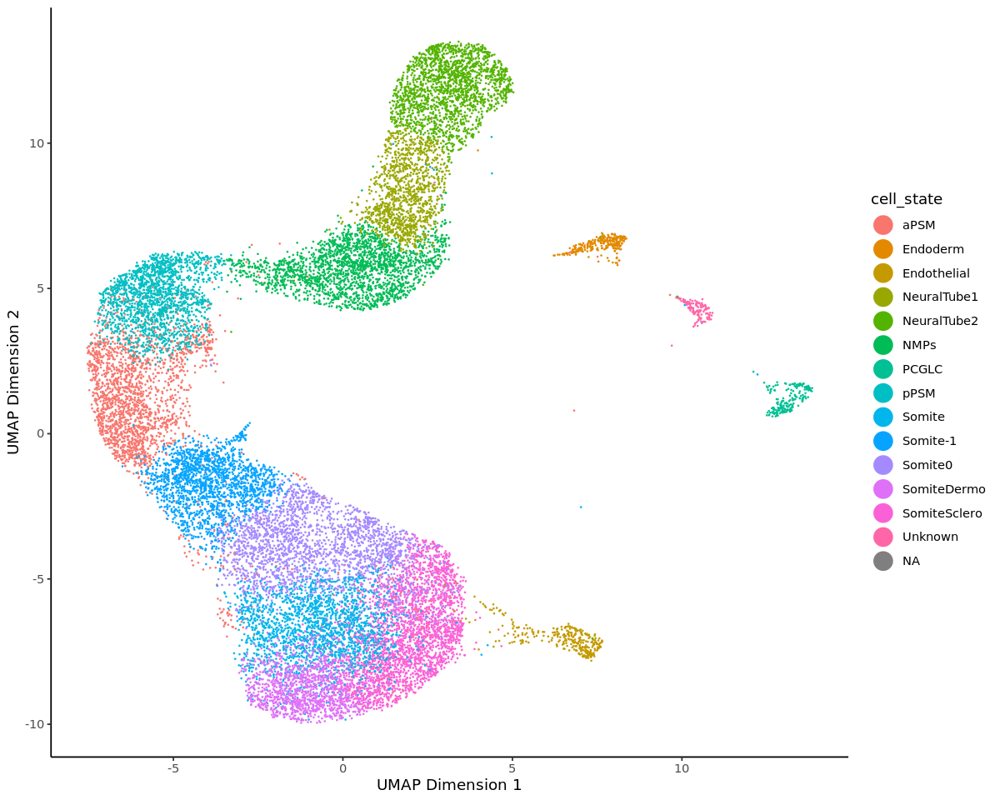

In [8]:
options(repr.plot.width=10, repr.plot.height=8)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=percent.mt)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis(trans='log2') +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=percent.ribo)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=percent.mt<2)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=batch)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=timepoint)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=cell_state)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

In [9]:
io$s.genes.ensid <- '/nfs/research/marioni/Leah/data/cell_cycle_genes/s_genes_ENS.txt'
io$g2m.genes.ensid <- '/nfs/research/marioni/Leah/data/cell_cycle_genes/g2m_genes_ENS.txt'
io$k <- 30

In [10]:
srat_veenvliet <- subset(srat_veenvliet, subset = (percent.mt>io$min_percent.mt) & (percent.mt<io$max_percent.mt) & (nFeature_RNA>io$min_nFeature_RNA) & (nCount_RNA>io$min_nCount_RNA))
srat_veenvliet_list <- SplitObject(srat_veenvliet, split.by = "batch")
md_list <- list()
for (b in unique(md$batch)) {
    sce_tmp <- as.SingleCellExperiment(srat_veenvliet_list[[b]])
    sce_tmp <- cxds_bcds_hybrid(sce_tmp, estNdbl=TRUE)
    md_list[[b]] <- merge(as.data.table(md[batch==b]), as.data.table(colData(sce_tmp))[,c("cell", "cxds_score", "cxds_call", "bcds_score", "bcds_call", "hybrid_score", "hybrid_call")], all.x=TRUE, by="cell")
    md_list[[b]][,pass_QC := FALSE]
    md_list[[b]][cell %in% Cells(srat_veenvliet_list[[b]]), pass_QC := TRUE]
    rownames(md_list[[b]]) <- md_list[[b]]$cell
    srat_veenvliet_list[[b]]@meta.data <- md_list[[b]][pass_QC==TRUE]
    rownames(srat_veenvliet_list[[b]]@meta.data) <- srat_veenvliet_list[[b]]@meta.data$cell

    srat_veenvliet_list[[b]] <- NormalizeData(srat_veenvliet_list[[b]])
    srat_veenvliet_list[[b]] <- FindVariableFeatures(srat_veenvliet_list[[b]])
    srat_veenvliet_list[[b]]@assays$RNA@scale.data <- as.matrix(srat_veenvliet_list[[b]]@assays$RNA@data)
    srat_veenvliet_list[[b]] <- RunPCA(srat_veenvliet_list[[b]], verbose=FALSE)
    srat_veenvliet_list[[b]] <- FindNeighbors(srat_veenvliet_list[[b]], k.param=io$k, reduction = "pca")
    rownames(srat_veenvliet_list[[b]]@meta.data) <- srat_veenvliet_list[[b]]@meta.data$cell
    srat_veenvliet_list[[b]] <- CellCycleScoring(srat_veenvliet_list[[b]],
                                             s.features = fread(io$s.genes.ensid, header = FALSE)$V1,
                                             g2m.features = fread(io$g2m.genes.ensid, header = FALSE)$V1,
                                             set.ident = FALSE
                                            )

    tmp <- data.table(hybrid_map = rowSums(srat_veenvliet_list[[b]]@graphs$RNA_nn[,md_list[[b]][hybrid_call==TRUE]$cell])/io$k,
                      cell = rownames(srat_veenvliet_list[[b]]@graphs$RNA_snn))
    md_list[[b]] <- merge(md_list[[b]], tmp, by = "cell", all.x=TRUE)
    md_list[[b]][hybrid_call==TRUE, hybrid_map := NA]
    md_list[[b]][,hybrid_call2 := TRUE]
    md_list[[b]][hybrid_map<=((sum(md_list[[b]][pass_QC==TRUE]$hybrid_call==TRUE))/(dim(md_list[[b]][pass_QC==TRUE])[1])), hybrid_call2 := FALSE]
    md_list[[b]][pass_QC==FALSE, hybrid_call2 := NA]
    rownames(md_list[[b]]) <- md_list[[b]]$cell

    md_list[[b]] <- merge(md_list[[b]], srat_veenvliet_list[[b]]@meta.data[,c("cell", "S.Score", "G2M.Score", "Phase")], by="cell", all.x=TRUE)
    rownames(md_list[[b]]) <- md_list[[b]]$cell
}
md <- rbindlist(md_list)
rownames(md) <- md$cell
srat_veenvliet@meta.data <- md

Setting levels: control = 0, case = 1

Setting direction: controls < cases



[08:13:08] WARNING: amalgamation/../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases



[08:14:04] WARNING: amalgamation/../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases



[08:14:52] WARNING: amalgamation/../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases



[08:16:11] WARNING: amalgamation/../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN

Setting levels: control = 0, case = 1

Setting direction: controls < cases



[08:17:33] WARNING: amalgamation/../src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


Setting levels: control = 0, case = 1

Setting direction: controls < cases

Setting levels: control = 0, case = 1

Setting direction: controls < cases

Computing nearest neighbor graph

Computing SNN



Warning message:
“The default method for RunUMAP has changed from calling Python UMAP via reticulate to the R-native UWOT using the cosine metric
To use Python UMAP via reticulate, set umap.method to 'umap-learn' and metric to 'correlation'
This message will be shown once per session”


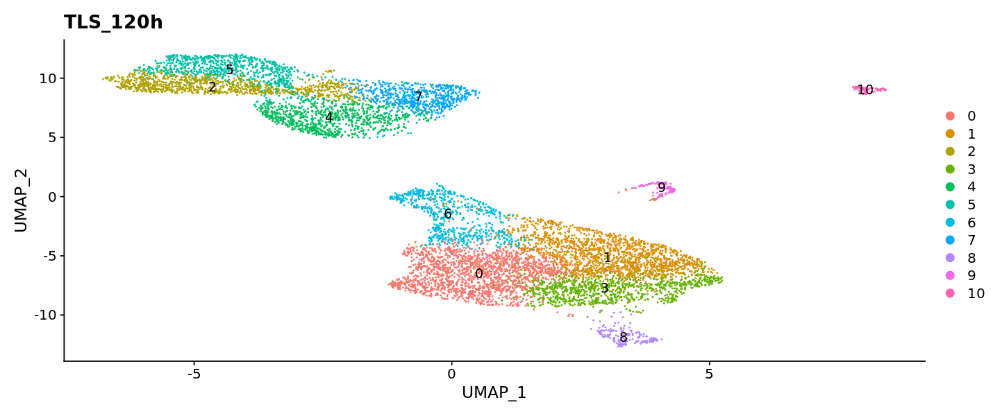

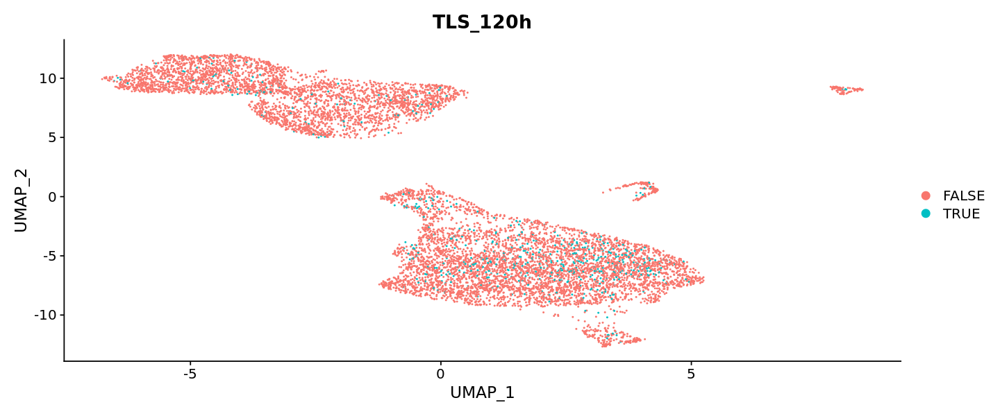

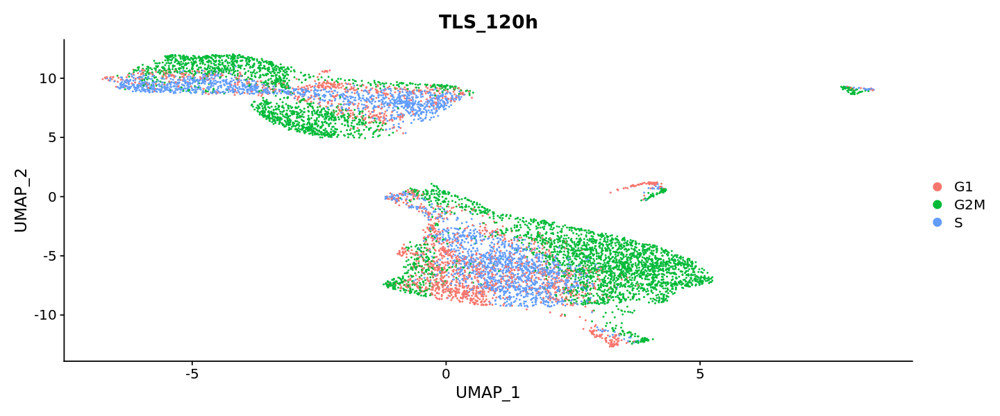

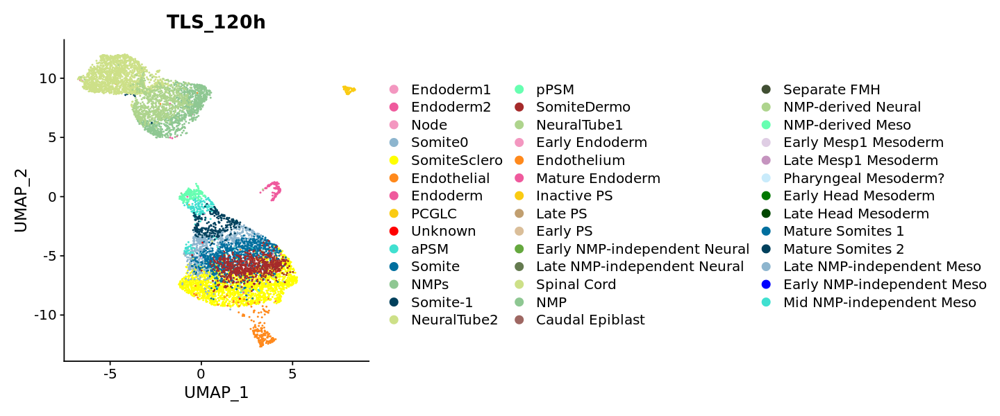

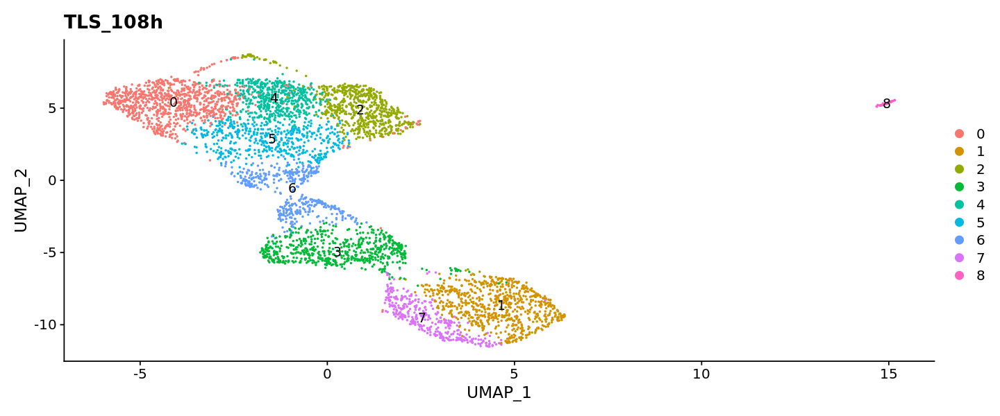

...

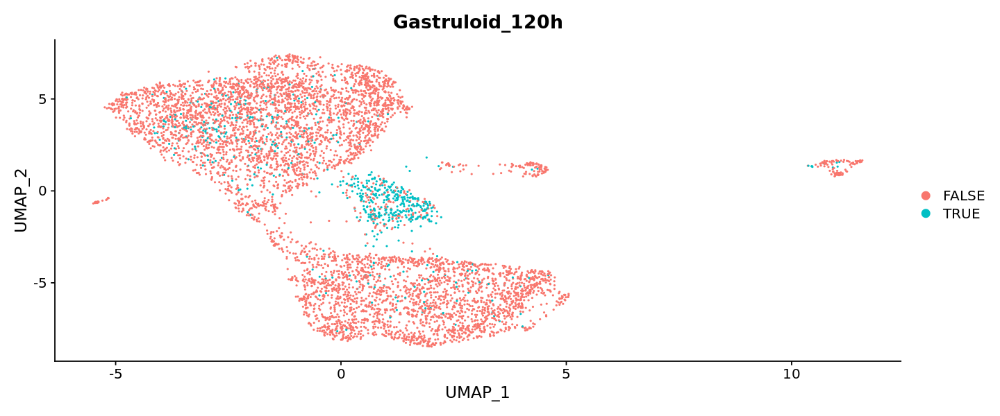

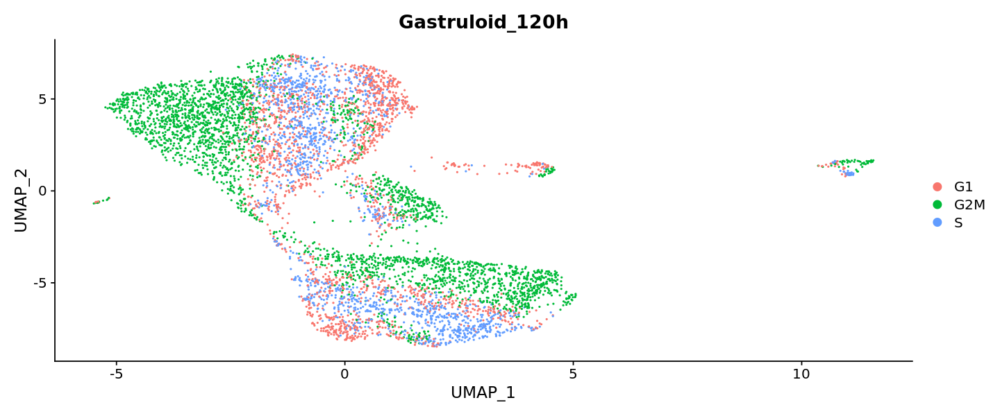

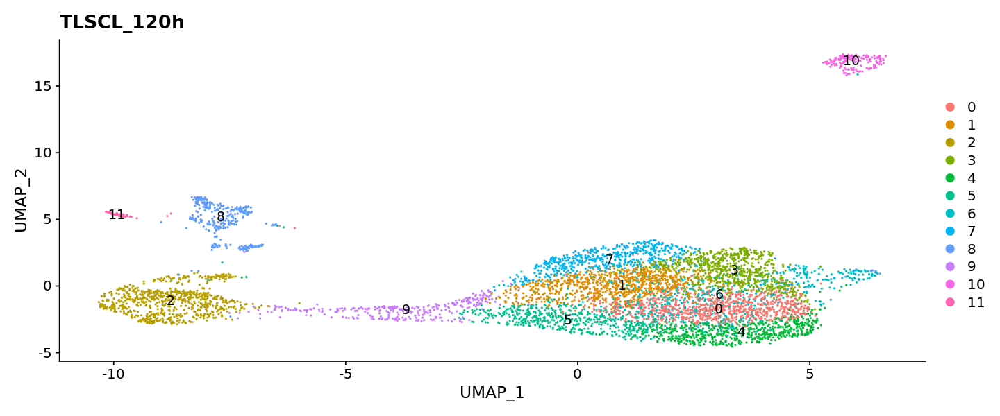

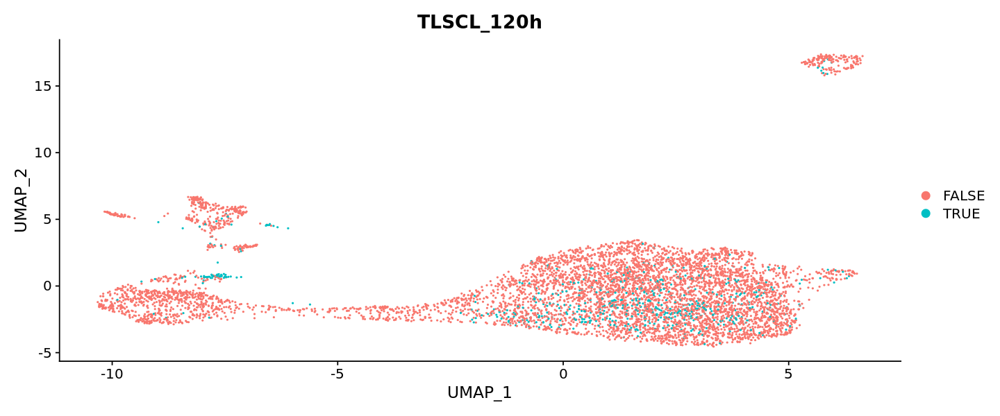

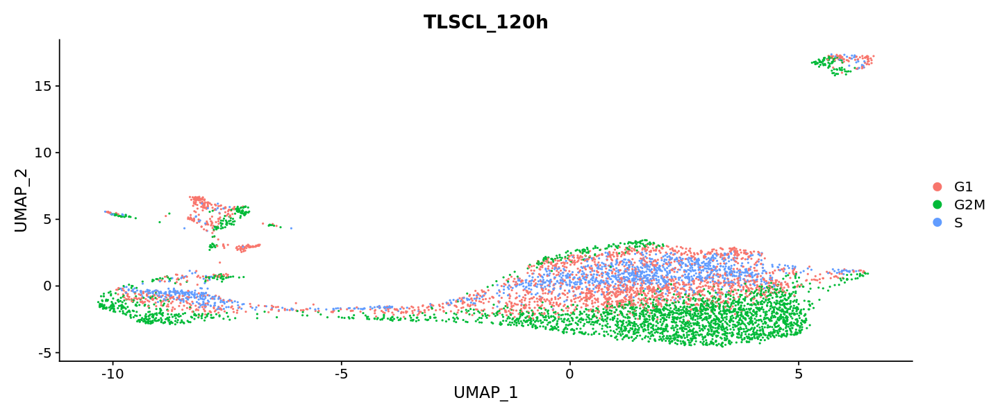

In [11]:
options(repr.plot.width=12, repr.plot.height=5)
for (b in unique(md$batch)) {
    srat_veenvliet_list[[b]]@meta.data <- srat_veenvliet_list[[b]]@meta.data[Cells(srat_veenvliet_list[[b]]),]
    srat_veenvliet_list[[b]] <- RunUMAP(srat_veenvliet_list[[b]], dims=1:50, verbose=FALSE)
    srat_veenvliet_list[[b]] <- FindClusters(srat_veenvliet_list[[b]], resolution = 0.6, verbose=FALSE)
    p <- DimPlot(srat_veenvliet_list[[b]], reduction = "umap", label = TRUE) + ggtitle(b)
    print(p)
    p <- DimPlot(srat_veenvliet_list[[b]], reduction = "umap", group.by = "hybrid_call") + ggtitle(b)
    print(p)
    p <- DimPlot(srat_veenvliet_list[[b]], reduction = "umap", group.by = "Phase") + ggtitle(b)
    print(p)
    if (!all(is.na(srat_veenvliet_list[[b]]@meta.data$cell_state))) {
        p <- DimPlot(srat_veenvliet_list[[b]], reduction = "umap", group.by = "cell_state", cols=cluster_colours) + ggtitle(b)
        print(p)
    }
}

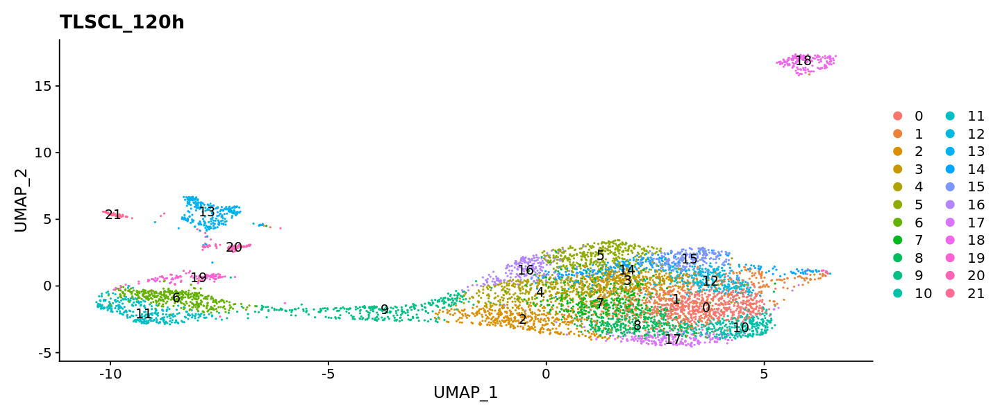

In [12]:
srat_veenvliet_list[[b]] <- FindClusters(srat_veenvliet_list[[b]], resolution = 2, verbose=FALSE)
DimPlot(srat_veenvliet_list[[b]], reduction = "umap", label = TRUE) + ggtitle(b)

In [13]:
srat_veenvliet@meta.data <- as.data.frame(srat_veenvliet@meta.data)
rownames(srat_veenvliet@meta.data) <- srat_veenvliet@meta.data$cell
srat_veenvliet@meta.data <- srat_veenvliet@meta.data[Cells(srat_veenvliet),]
srat_veenvliet <- subset(srat_veenvliet, cells = Cells(srat_veenvliet)[!(Cells(srat_veenvliet) %in% srat_veenvliet_list[['Gastruloid_120h']]@meta.data$cell[srat_veenvliet_list[['Gastruloid_120h']]@meta.data$`RNA_snn_res.0.6`==8])])
srat_veenvliet <- subset(srat_veenvliet, cells = Cells(srat_veenvliet)[!(Cells(srat_veenvliet) %in% srat_veenvliet_list[['TLSCL_120h']]@meta.data$cell[srat_veenvliet_list[['TLSCL_120h']]@meta.data$`RNA_snn_res.2`==19])])
md <- md[cell %in% Cells(srat_veenvliet)]

In [14]:
genemeta[symbol %in% c('Sox2', 'Cdx2', 'T', 'Tbx6', 'Nodal', 'Mesp1', 'Bcl6b', 'Icam2')]

ens_id,symbol,cc_gene,hvg,hvgs_gastr_nocc,hvgs_gastr_wcc,hvgs_atlas_nocc,hvgs_atlas_wcc,hvgs_both_nocc,hvgs_both_wcc,mito
<chr>,<chr>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>
ENSMUSG00000074637,Sox2,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000029646,Cdx2,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000030544,Mesp1,FALSE,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000030699,Tbx6,FALSE,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000037171,Nodal,FALSE,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000000317,Bcl6b,FALSE,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000001029,Icam2,FALSE,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE
ENSMUSG00000062327,T,FALSE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,TRUE,FALSE


Computing nearest neighbor graph

Computing SNN



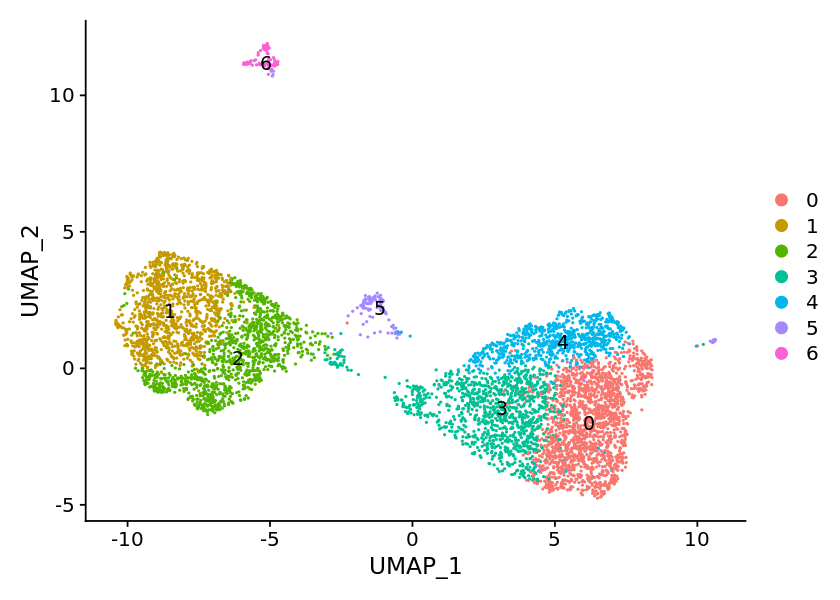

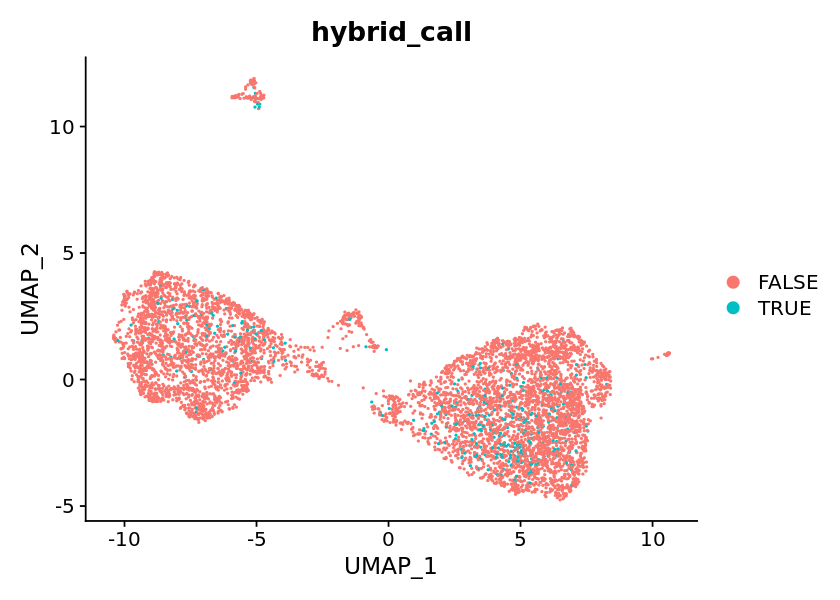

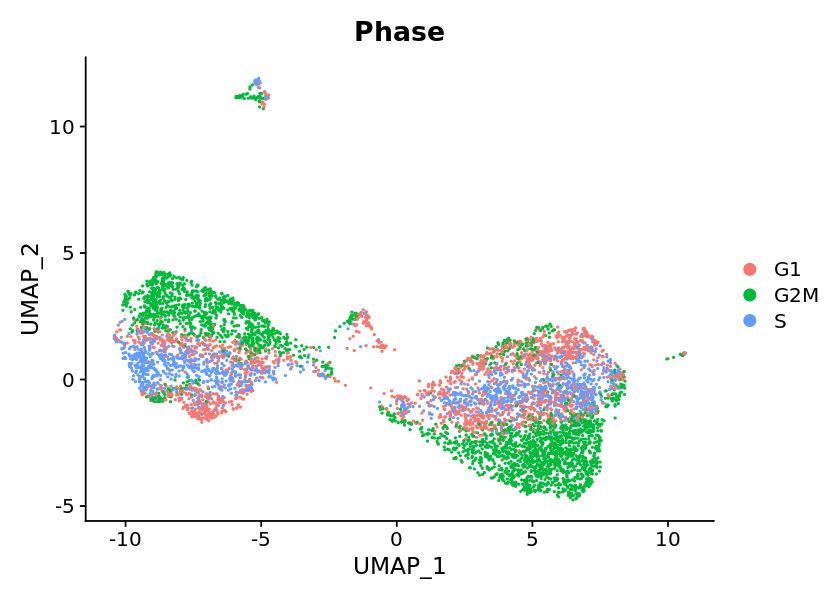

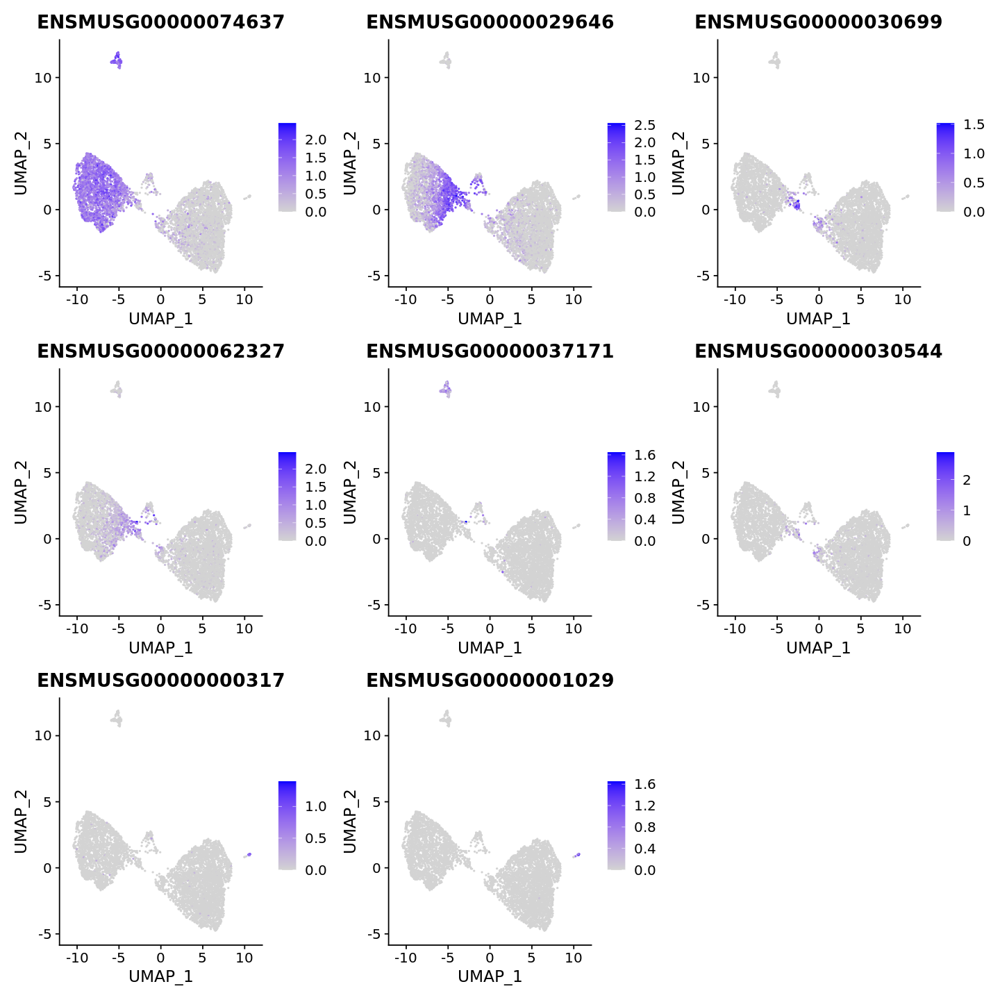

In [15]:
srat_gastr_tocluster <- subset(srat_veenvliet, subset = batch=='Gastruloid_120h')
srat_gastr_tocluster <- NormalizeData(srat_gastr_tocluster)
srat_gastr_tocluster <- FindVariableFeatures(srat_gastr_tocluster)
srat_gastr_tocluster@assays$RNA@scale.data <- as.matrix(srat_gastr_tocluster@assays$RNA@data)
srat_gastr_tocluster <- RunPCA(srat_gastr_tocluster, verbose=FALSE)
srat_gastr_tocluster <- FindNeighbors(srat_gastr_tocluster, k.param=io$k, reduction = "pca")
srat_gastr_tocluster <- RunUMAP(srat_gastr_tocluster, dims=1:50, verbose=FALSE)
srat_gastr_tocluster <- FindClusters(srat_gastr_tocluster, resolution = 0.3, verbose=FALSE)
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(srat_gastr_tocluster, reduction = "umap", label = TRUE)
DimPlot(srat_gastr_tocluster, reduction = "umap", group.by = "hybrid_call")
DimPlot(srat_gastr_tocluster, reduction = "umap", group.by = "Phase")
options(repr.plot.width=12, repr.plot.height=12)
FeaturePlot(srat_gastr_tocluster, features = c('ENSMUSG00000074637', 'ENSMUSG00000029646', 'ENSMUSG00000030699', 'ENSMUSG00000062327', 'ENSMUSG00000037171', 'ENSMUSG00000030544', 'ENSMUSG00000000317', 'ENSMUSG00000001029'))

neural2_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='1']
neural1_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='2']
node_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='6']
gut_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='5']
meso1_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='3']
meso2_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='4']
meso3_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='0']
srat_veenvliet@meta.data[neural2_cells,]$cell_state <- 'NeuralTube2'
srat_veenvliet@meta.data[neural1_cells,]$cell_state <- 'NeuralTube1'
srat_veenvliet@meta.data[node_cells,]$cell_state <- 'Node'
srat_veenvliet@meta.data[gut_cells,]$cell_state <- 'Endoderm'
srat_veenvliet@meta.data[meso1_cells,]$cell_state <- 'aPSM'
srat_veenvliet@meta.data[meso2_cells,]$cell_state <- 'Somite0'
srat_veenvliet@meta.data[meso3_cells,]$cell_state <- 'Somite-1'

Computing nearest neighbor graph

Computing SNN



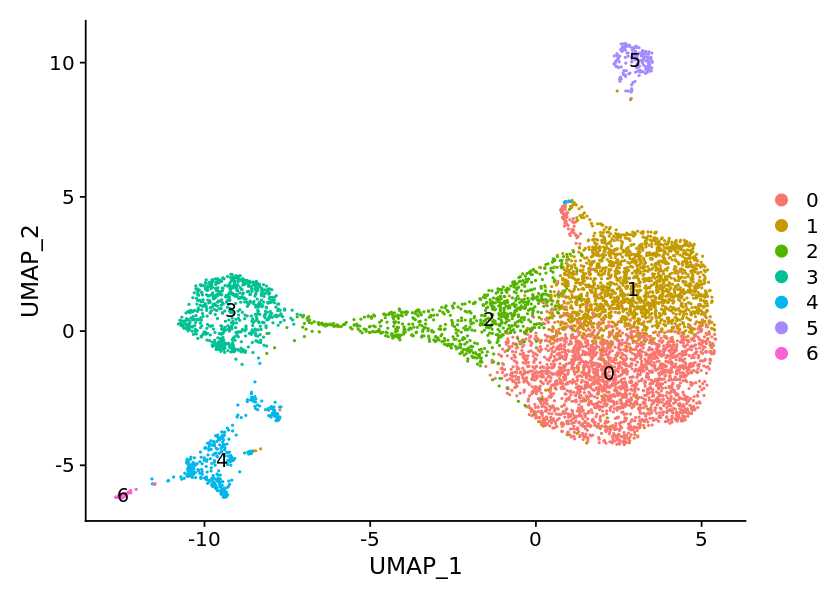

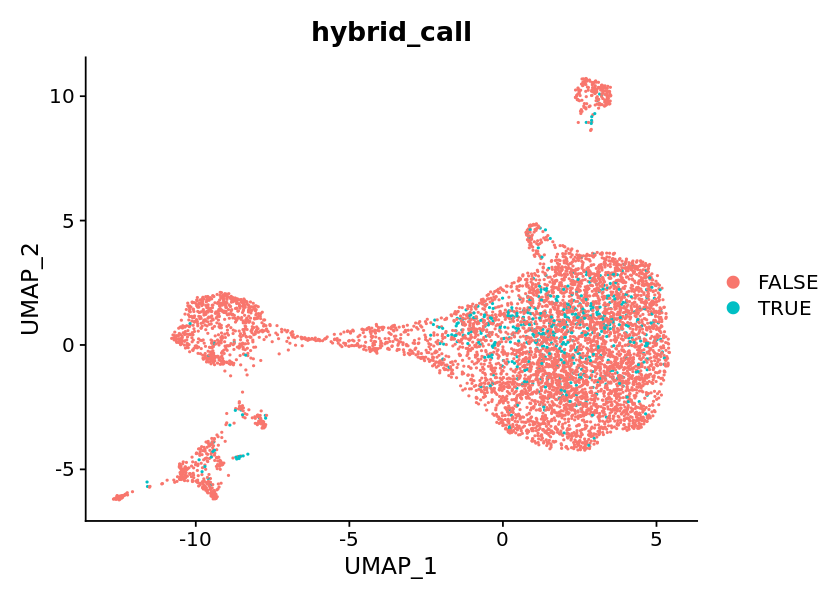

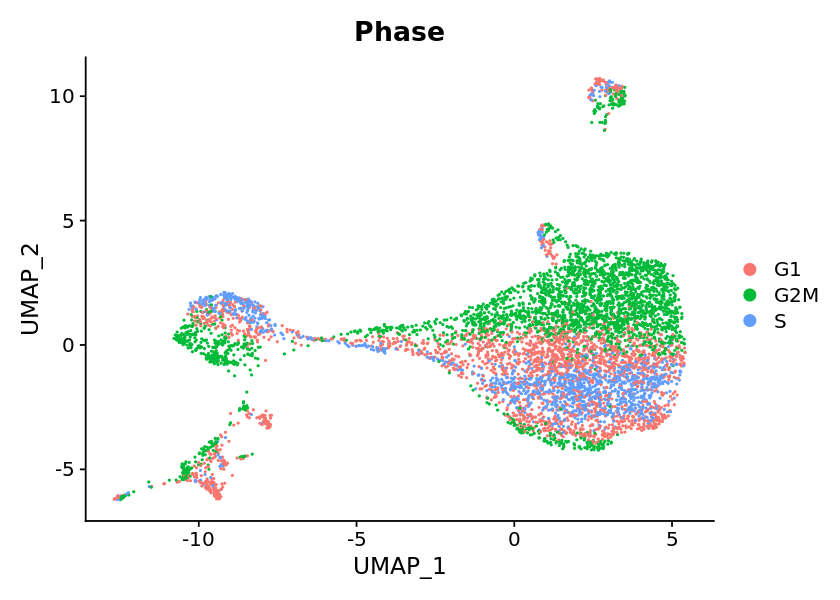

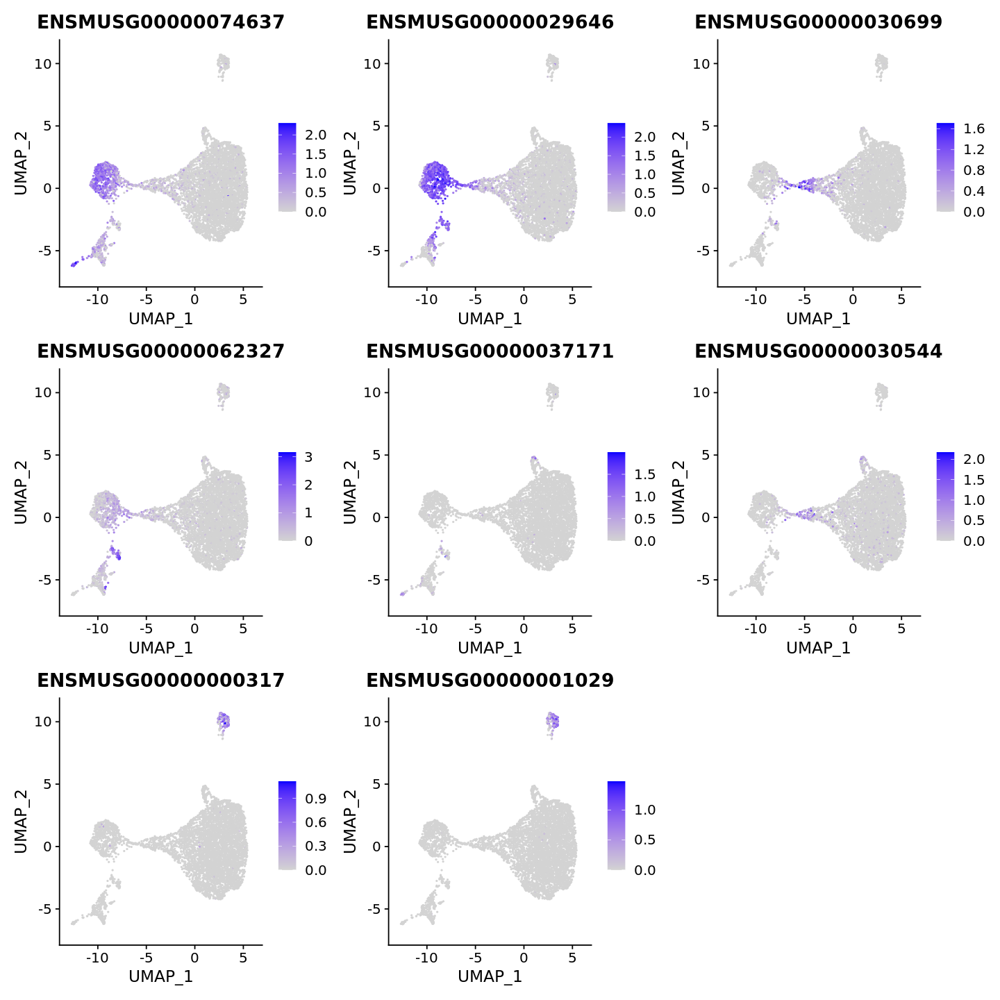

In [16]:
srat_gastr_tocluster <- subset(srat_veenvliet, subset = batch=='TLSCL_120h')
srat_gastr_tocluster <- NormalizeData(srat_gastr_tocluster)
srat_gastr_tocluster <- FindVariableFeatures(srat_gastr_tocluster)
srat_gastr_tocluster@assays$RNA@scale.data <- as.matrix(srat_gastr_tocluster@assays$RNA@data)
srat_gastr_tocluster <- RunPCA(srat_gastr_tocluster, verbose=FALSE)
srat_gastr_tocluster <- FindNeighbors(srat_gastr_tocluster, k.param=io$k, reduction = "pca")
srat_gastr_tocluster <- RunUMAP(srat_gastr_tocluster, dims=1:50, verbose=FALSE)
srat_gastr_tocluster <- FindClusters(srat_gastr_tocluster, resolution = 0.3, verbose=FALSE)
options(repr.plot.width=7, repr.plot.height=5)
DimPlot(srat_gastr_tocluster, reduction = "umap", label = TRUE)
DimPlot(srat_gastr_tocluster, reduction = "umap", group.by = "hybrid_call")
DimPlot(srat_gastr_tocluster, reduction = "umap", group.by = "Phase")
options(repr.plot.width=12, repr.plot.height=12)
FeaturePlot(srat_gastr_tocluster, features = c('ENSMUSG00000074637', 'ENSMUSG00000029646', 'ENSMUSG00000030699', 'ENSMUSG00000062327', 'ENSMUSG00000037171', 'ENSMUSG00000030544', 'ENSMUSG00000000317', 'ENSMUSG00000001029'))

endothelium_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='5']
neural_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='3']
meso1_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='2']
meso2_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='0']
meso3_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='1']
endoderm1_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='4']
endoderm2_cells <- srat_gastr_tocluster@meta.data$cell[srat_gastr_tocluster@meta.data$`RNA_snn_res.0.3`=='6']

srat_veenvliet@meta.data[neural_cells,]$cell_state <- 'NeuralTube1'
srat_veenvliet@meta.data[endothelium_cells,]$cell_state <- 'Endothelial'
srat_veenvliet@meta.data[endoderm1_cells,]$cell_state <- 'Endoderm1'
srat_veenvliet@meta.data[endoderm2_cells,]$cell_state <- 'Endoderm2'
srat_veenvliet@meta.data[meso1_cells,]$cell_state <- 'pPSM'
srat_veenvliet@meta.data[meso2_cells,]$cell_state <- 'Somite0'
srat_veenvliet@meta.data[meso3_cells,]$cell_state <- 'Somite-1'

Warning message:
“Removed 12471 rows containing missing values (geom_point).”
Warning message:
“Removed 12471 rows containing missing values (geom_point).”


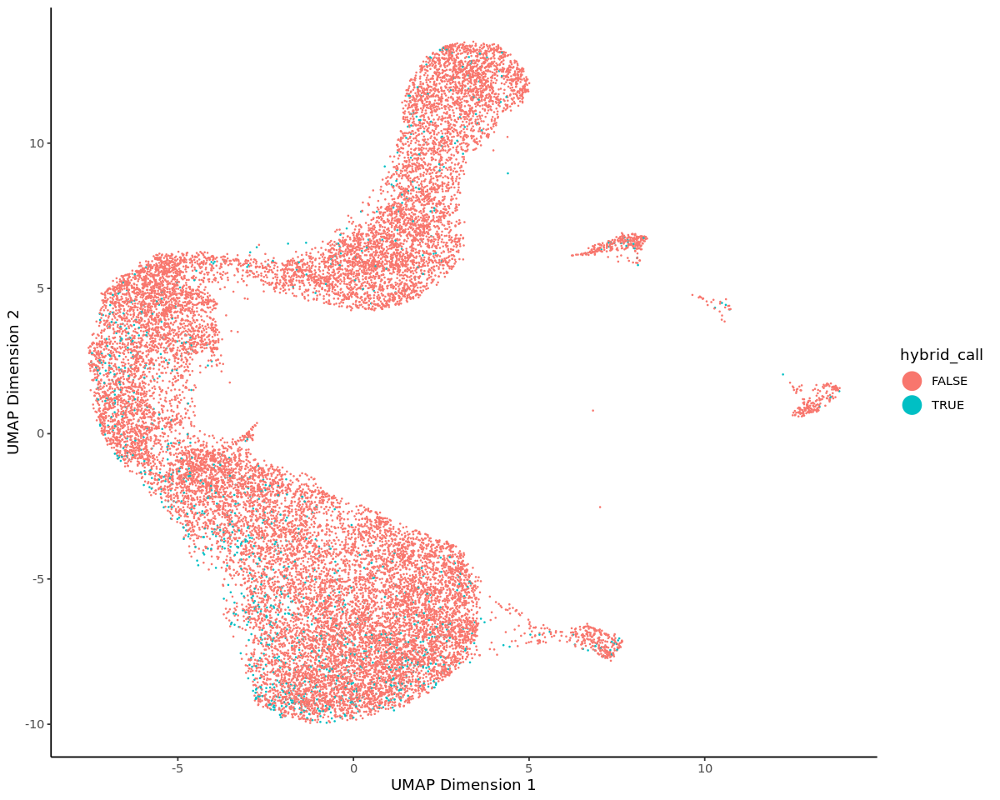

Warning message:
“Removed 12471 rows containing missing values (geom_point).”


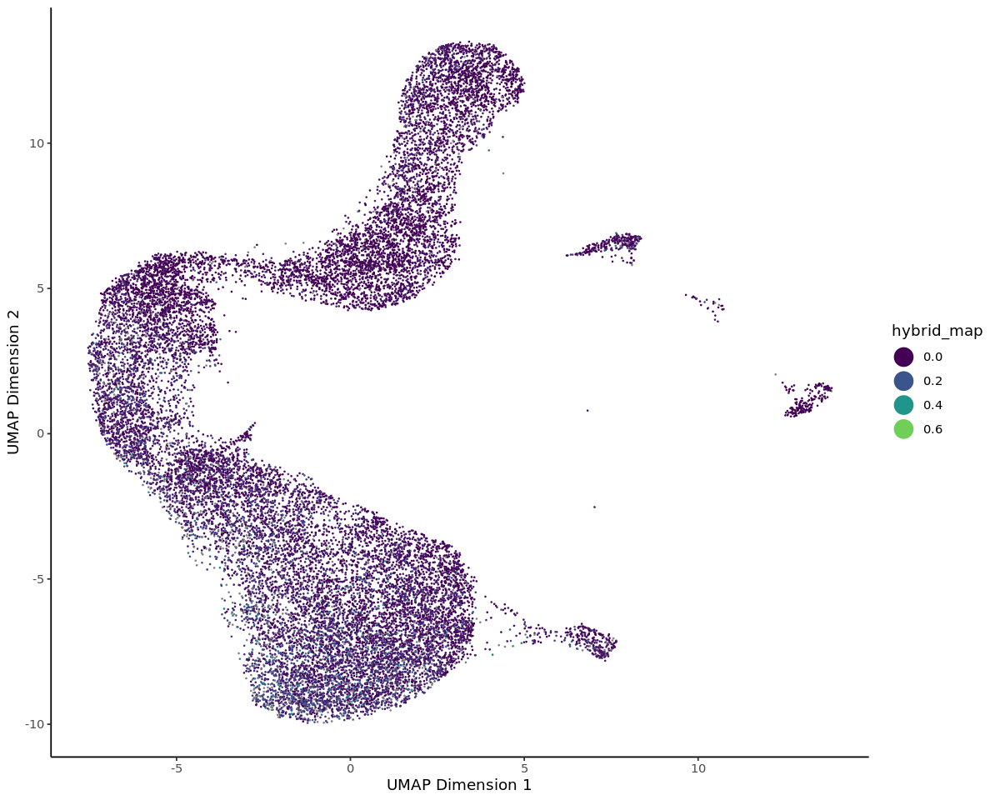

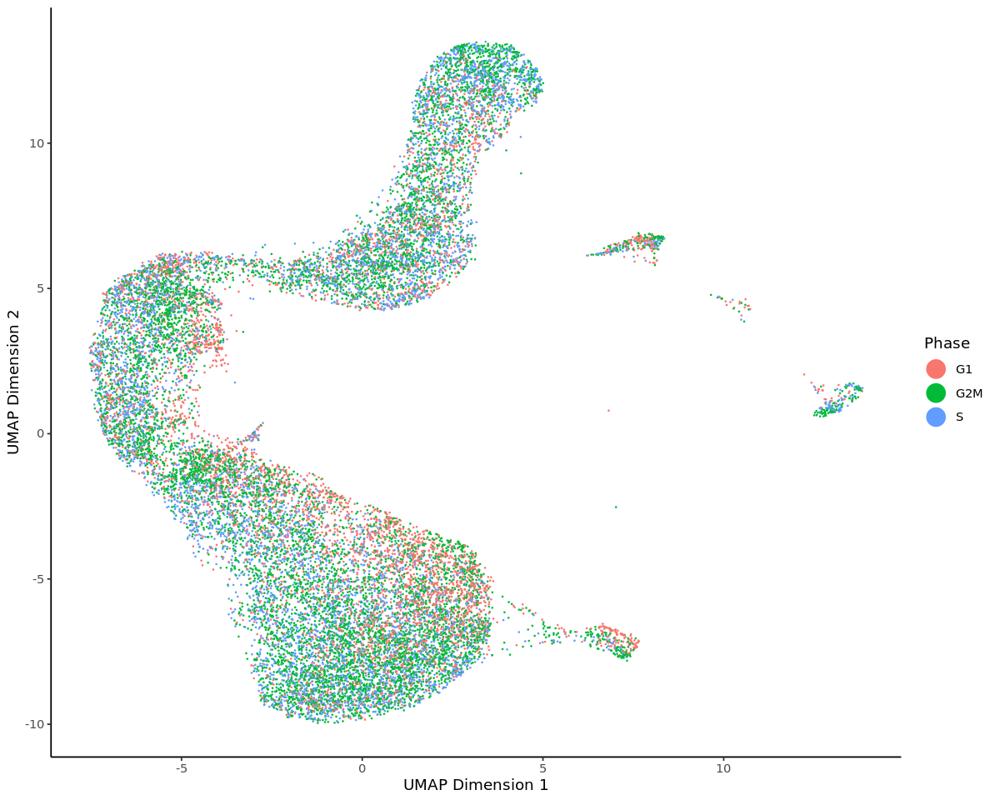

In [17]:
options(repr.plot.width=10, repr.plot.height=8)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=hybrid_call)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=hybrid_map)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  scale_colour_viridis() +
  theme_classic()
print(p)
p <- ggplot(data=md, mapping = aes(x=UMAP_1, y=UMAP_2, colour=Phase)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

# Map to my gastruloids

In [18]:
suppressPackageStartupMessages(library(SingleCellExperiment))
suppressPackageStartupMessages(library(data.table))
suppressPackageStartupMessages(library(purrr))
suppressPackageStartupMessages(library(ggplot2))
suppressPackageStartupMessages(library(scran))
suppressPackageStartupMessages(library(batchelor))
suppressPackageStartupMessages(library(tools))
suppressPackageStartupMessages(library(stringr))
suppressPackageStartupMessages(library(umap))

In [19]:
source('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/gastruloids_scRNAseq/pipeline/mapping/mapping_functions.R')

mapNoAtlas <- function(sce, meta, k = 30, npcs = 50, return.list = FALSE){
  
  message("Normalizing joint dataset...")
  sce_all <- SingleCellExperiment::SingleCellExperiment(list(counts=counts(sce)))
  big_sce <- multiBatchNorm(sce_all, batch=c(meta$batch))
  message("Done\n")
  
  message("Computing highly variable genes...")
  hvgs    <- getHVGs(big_sce, block=c(meta$batch))
  message("Done\n")
  
  message("Performing PCA...")
  full_pca <- multiBatchPCA(big_sce,
                           batch=c(meta$batch),
                           subset.row = hvgs,
                           d = npcs,
                           preserve.single = TRUE,
                           get.variance=TRUE,
                           assay.type = "logcounts")
  big_pca <- full_pca[[1]]
  rownames(big_pca) <- colnames(big_sce)
  message("Done\n")
  
  message("Batch effect correction...")  
  order_df        <- meta[!duplicated(meta$batch), c("timepoint", "batch")]
  order_df$ncells <- sapply(order_df$batch, function(x) sum(meta$batch == x))
  order_df$timepoint  <- factor(order_df$timepoint, 
                                levels = rev(c("d7", "d6", "d5", 'd4.5_d5', "d4.5", 'd4_d4.5', "d4", "d3.5_d4", "d3.5", "d3_d3.5", "d3"))
                               )
  order_df       <- order_df[order(order_df$timepoint, order_df$ncells, decreasing = TRUE),]
  order_df$timepoint <- as.character(order_df$timepoint)
  message(order_df)
  
  set.seed(42)
  corrected <- doBatchCorrect(counts          = logcounts(big_sce[hvgs,]), 
                              timepoints      = meta$timepoint, 
                              samples         = meta$batch, 
                              timepoint_order = order_df$timepoint, 
                              sample_order    = order_df$batch, 
                              pc_override     = big_pca,
                              npc             = npcs)
  message("Done\n")
  out <- list()
  out$corrected <- corrected
  out$pca <- full_pca
  message("Done\n")
  
  return(out)
  
}

io$min.counts.per.gene <- 50
io$npcs <- 50

In [20]:
g_meta <- fread('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/plot_df_joined.txt.gz')
g_meta[MULTI_class %in% as.vector(unlist(neural)), gastr_type := "neural"]
g_meta[MULTI_class %in% as.vector(unlist(meso)), gastr_type := "meso"]
g_meta[MULTI_class %in% as.vector(unlist(intermediate)), gastr_type := "intermediate"]
g_srat <- readRDS("/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat.rds")[,g_meta$cell]
g_mapping <- readRDS('/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/mapping/gastr_mapping_2.rds')

g_meta$dataset <- 'Gastruloids'

In [21]:
run_correct <- function(srat_query, srat_rosen, meta_query, meta_rosen, k, npcs) {
    sce_query <- Seurat::as.SingleCellExperiment( srat_query )
    rownames(colData(sce_query)) <- colData(sce_query)$cell

    sce_rosen <- Seurat::as.SingleCellExperiment( srat_rosen )
    rownames(colData(sce_rosen)) <- colData(sce_rosen)$cell
    meta_rosen$timepoint <- meta_rosen$timepoint.base
    meta_rosen$batch <- meta_rosen$experiment

    genes <- intersect(rownames(sce_rosen), rownames(sce_query))
    genes <- genes[genes %in% as.data.table(srat_query@assays$RNA@meta.features)[!(cc_gene)]$ens_id]

    sce_all <- SingleCellExperiment::SingleCellExperiment(
        list(counts=Matrix::Matrix(cbind(counts(sce_rosen[genes,]),counts(sce_query[genes,])),sparse=TRUE)))
    meta_all <- rbind(meta_rosen, meta_query, fill=TRUE)
    
    message("MNN mapping...")
    return(mapNoAtlas(sce_all, meta_all, k = k, npcs = npcs, return.list = FALSE))
}

In [27]:
srat_veenvliet@meta.data <- as.data.frame(srat_veenvliet@meta.data)
rownames(srat_veenvliet@meta.data) <- srat_veenvliet@meta.data$cell

srat_query_gastr <- subset(srat_veenvliet, subset=organoid=="gastr")
correct_gastr <- run_correct(srat_query=srat_query_gastr, srat_rosen=g_srat, meta_query=as.data.table(srat_query_gastr@meta.data), meta_rosen=g_meta, k=io$k, npcs=io$npcs)
meta_gastr <- rbind(g_meta, as.data.table(srat_query_gastr@meta.data), fill=TRUE)

srat_query_TLS <- subset(srat_veenvliet, subset=organoid=="TLS")
correct_TLS <- run_correct(srat_query=srat_query_TLS, srat_rosen=g_srat, meta_query=as.data.table(srat_query_TLS@meta.data), meta_rosen=g_meta, k=io$k, npcs=io$npcs)
meta_TLS <- rbind(g_meta, as.data.table(srat_query_TLS@meta.data), fill=TRUE)

srat_query_TLSCL <- subset(srat_veenvliet, subset=organoid=="TLSCL")
correct_TLSCL <- run_correct(srat_query=srat_query_TLSCL, srat_rosen=g_srat, meta_query=as.data.table(srat_query_TLSCL@meta.data), meta_rosen=g_meta, k=io$k, npcs=io$npcs)
meta_TLSCL <- rbind(g_meta, as.data.table(srat_query_TLSCL@meta.data), fill=TRUE)

MNN mapping...

Normalizing joint dataset...

Done


Computing highly variable genes...

Done


Performing PCA...

Done


Batch effect correction...

c("d5", "d5", "d4.5_d5", "d4_d4.5", "d4_d4.5", "d4", "d3.5_d4", "d3", "d3")c("exp1_d5", "Gastruloid_120h", "exp6_d4.5_d5", "exp3C_d4_d4.5", "exp3B_d4_d4.5", "gastr_d4", "exp5_d3.5_d4", "exp4_d3", "gastr_d3")c(9042, 6058, 16272, 5069, 4239, 2024, 20767, 9241, 2176)

Done


Done


MNN mapping...

Normalizing joint dataset...

Done


Computing highly variable genes...

Done


Performing PCA...

Done


Batch effect correction...

c("d5", "d5", "d4.5_d5", "d4.5", "d4_d4.5", "d4_d4.5", "d4", "d4", "d3.5_d4", "d3", "d3")c("exp1_d5", "TLS_120h", "exp6_d4.5_d5", "TLS_108h", "exp3C_d4_d4.5", "exp3B_d4_d4.5", "TLS_96h", "gastr_d4", "exp5_d3.5_d4", "exp4_d3", "gastr_d3")c(9042, 8880, 16272, 4893, 5069, 4239, 6346, 2024, 20767, 9241, 2176)

Done


Done


MNN mapping...

Normalizing joint dataset...

Done


Computing highly variable genes...

Done


Pe

In [40]:
prep_for_Carine <- function(correct_sce, srat_query, srat_rosen, meta, genemeta, dim1_name='X1', dim2_name='X2') {
    
    cols <- c(dim1_name, dim2_name)
    
    UMAP <- umap(correct_sce$corrected, random_state=2402)
    tmp <- data.frame(UMAP$layout)
    tmp$cell <- rownames(tmp)
    tmp <- as.data.table(tmp)
    tmp <- setnames(tmp, c("X1", "X2"), c(dim1_name, dim2_name))
    plot_df_joined <- merge(tmp, meta, by=c("cell")) %>% as.data.table
    
    sce_query <- Seurat::as.SingleCellExperiment( srat_query )
    rownames(colData(sce_query)) <- colData(sce_query)$cell
    sce_rosen <- Seurat::as.SingleCellExperiment( srat_rosen )
    rownames(colData(sce_rosen)) <- colData(sce_rosen)$cell
    
    genes <- intersect(rownames(sce_rosen), rownames(sce_query))
    genes <- genes[genes %in% as.data.table(srat_query@assays$RNA@meta.features)[!(cc_gene)]$ens_id]
    
    # Load data
    rownames(plot_df_joined) <- plot_df_joined$cell
    merge_counts <- Matrix::Matrix(cbind(counts(sce_rosen[genes,]),counts(sce_query[genes,])),sparse=TRUE)
    plot_df_joined_toadd <- as.data.frame(plot_df_joined)
    rownames(plot_df_joined_toadd) <- plot_df_joined_toadd$cell
    plot_df_joined_toadd$cluster <- plot_df_joined_toadd$celltype_merge
    merge_srat <- CreateSeuratObject(counts=merge_counts,
                                     meta.data=plot_df_joined_toadd[colnames(merge_counts),]
                                    )
    
    umap_embeddings <- as.matrix(plot_df_joined[,..cols])
    colnames(umap_embeddings) <- c("X1", "X2")
    rownames(umap_embeddings) <- plot_df_joined$cell

    merge_srat@reductions[["pca"]] <- CreateDimReducObject(
      embeddings = correct_sce$corrected[Cells(merge_srat),],
      loadings = metadata(correct_sce$pca)$rotation,
      key = "PC",
      assay = "RNA"
    )
    merge_srat@reductions[["umap"]] <- CreateDimReducObject(
      embeddings = umap_embeddings[Cells(merge_srat),],
      key = "UMAP",
      assay = "RNA"
    )

    DefaultAssay(merge_srat) <- "RNA"

    VariableFeatures(merge_srat) <- rownames(merge_srat@reductions$pca@feature.loadings)

    genemeta <- genemeta[ens_id %in% rownames(merge_srat)]
    rownames(genemeta) <- genemeta$ens_id
    merge_srat[["RNA"]] <- AddMetaData(
        object = merge_srat[["RNA"]],
        metadata = genemeta
    )

    merge_data <- as.SingleCellExperiment(merge_srat)
    merge_data <- multiBatchNorm(merge_data, batch=colData(merge_data)$batch)
    merge_srat@assays$RNA@data <- logcounts(merge_data)
    
    return(merge_srat)
}

In [41]:
meta_TLS$celltype_merge <- meta_TLS$cluster
meta_TLS[dataset == 'veenvliet']$celltype_merge <- meta_TLS[dataset == 'veenvliet']$cell_state
srat_TLS <- prep_for_Carine(correct_sce=correct_TLS, srat_query=srat_query_TLS, srat_rosen=g_srat, meta=meta_TLS, genemeta=genemeta, dim1_name='X1_TLSInt', dim2_name='X2_TLSInt')

meta_gastr$celltype_merge <- meta_gastr$cluster
meta_gastr[dataset == 'veenvliet']$celltype_merge <- meta_gastr[dataset == 'veenvliet']$cell_state
srat_gastr <- prep_for_Carine(correct_sce=correct_gastr, srat_query=srat_query_gastr, srat_rosen=g_srat, meta=meta_gastr, genemeta=genemeta, dim1_name='X1_gastrInt', dim2_name='X2_gastrInt')

meta_TLSCL$celltype_merge <- meta_TLSCL$cluster
meta_TLSCL[dataset == 'veenvliet']$celltype_merge <- meta_TLSCL[dataset == 'veenvliet']$cell_state
srat_TLSCL <- prep_for_Carine(correct_sce=correct_TLSCL, srat_query=srat_query_TLSCL, srat_rosen=g_srat, meta=meta_TLSCL, genemeta=genemeta, dim1_name='X1_TLSCLInt', dim2_name='X2_TLSCLInt')


Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to PC_”
Warning message:
“No columnames present in cell embeddings, setting to 'PC_1:50'”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from UMAP to UMAP_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to UMAP_”
Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from PC to PC_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to PC_”
Warning message:
“No columnames present in cell embeddings, setting to 'PC_1:50'”
Warning message:
“Keys should be one or more alphanumeric characters followed by an un

In [42]:
saveRDS(srat_TLS, "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat_veenvlietTLS_merge.rds")
saveRDS(srat_gastr, "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat_veenvlietGastr_merge.rds")
saveRDS(srat_TLSCL, "/nfs/research/marioni/Leah/gastrulation_epigenetics/gastruloid_characterisation/data_dir/processed_files_Leah/scRNAseq/seurat_veenvlietTLSCL_merge.rds")

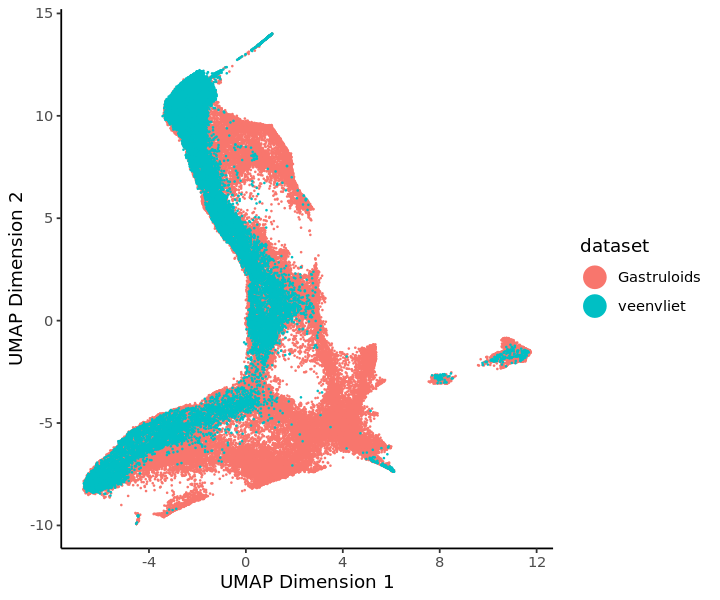

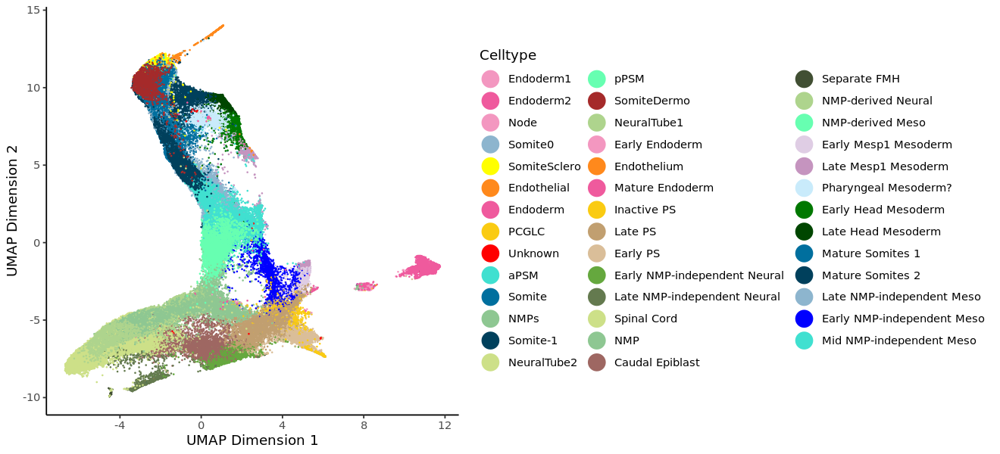

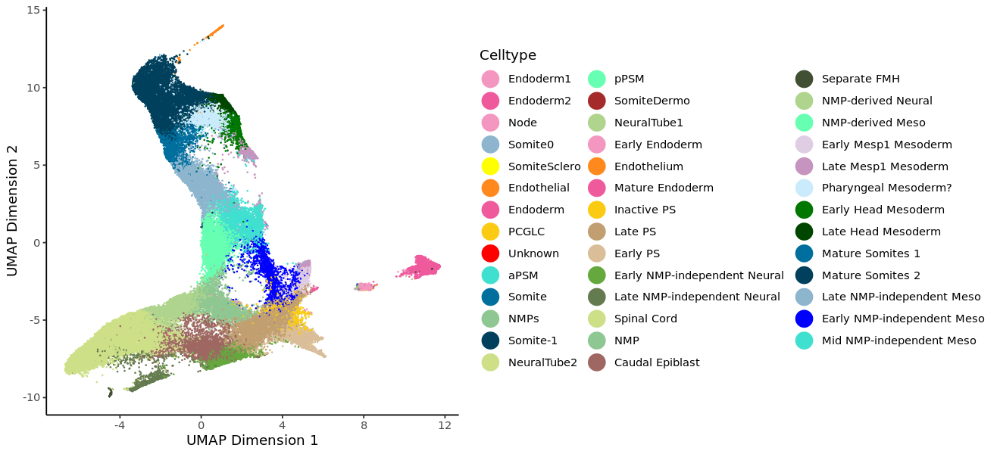

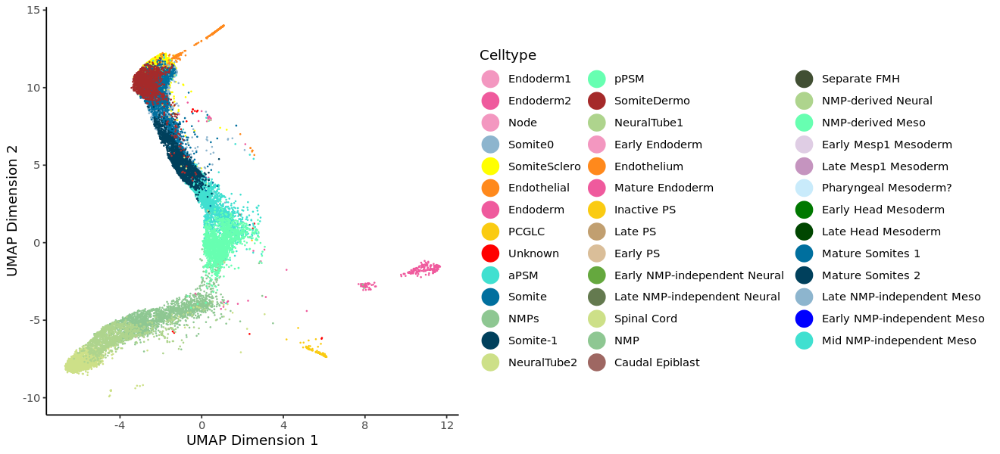

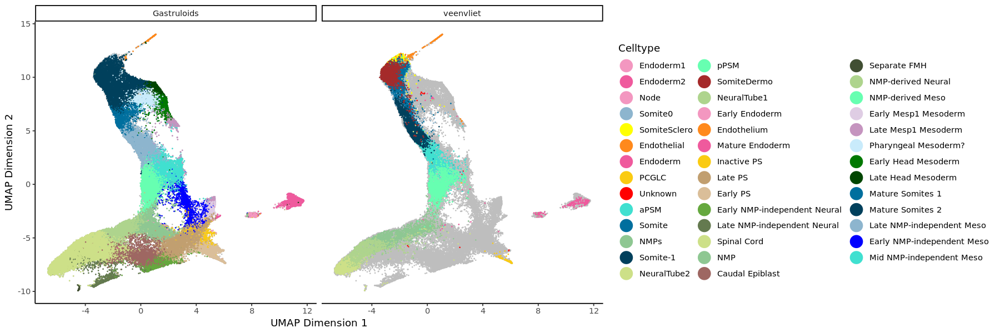

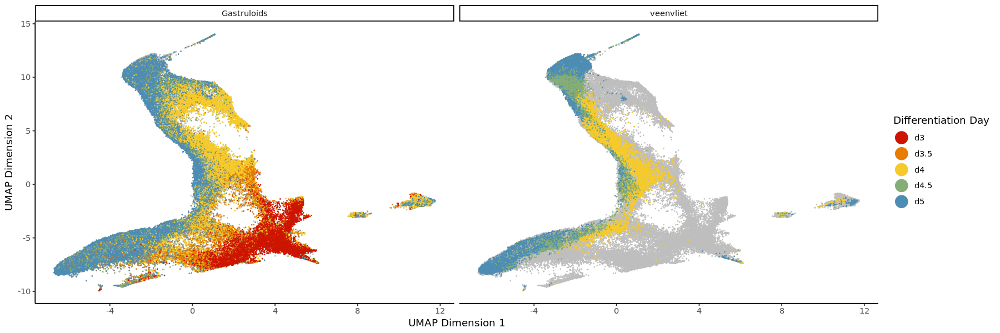

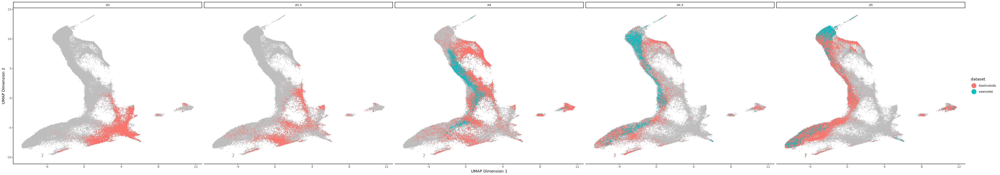

In [43]:
to.plot <- as.data.table(srat_TLS@meta.data)

options(repr.plot.width=6, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=dataset)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=11, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='Gastruloids'], mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='veenvliet'], mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=celltype_merge)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=timepoint)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = timepoint_colours, name = "Differentiation Day") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=40, repr.plot.height=7)
to.plot_shuffle <- to.plot[sample(nrow(to.plot)),]
to.plot_shuffle$timepoint <- factor(to.plot_shuffle$timepoint, levels=timepoint_order)
p <- ggplot(data=to.plot_shuffle[timepoint %in% timepoint_order], mapping = aes(x=X1_TLSInt, y=X2_TLSInt, colour=dataset)) +
  geom_point(data=select(to.plot_shuffle,-timepoint), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ timepoint, nrow=1)
print(p)

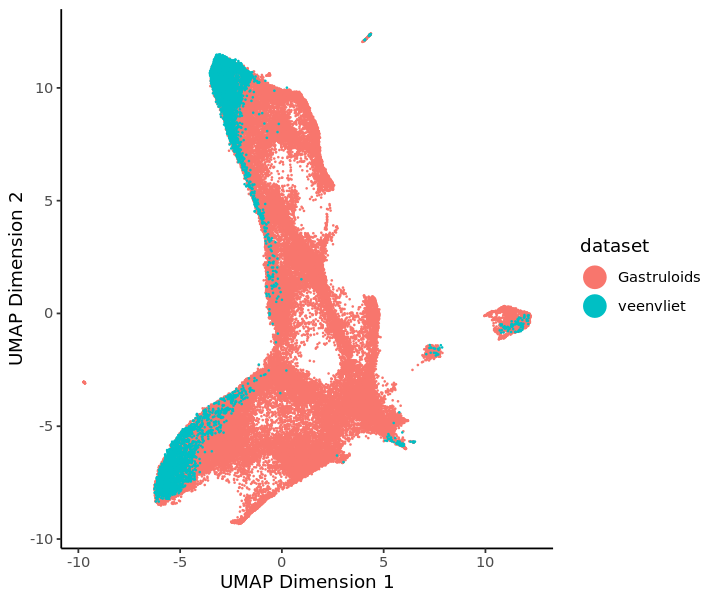

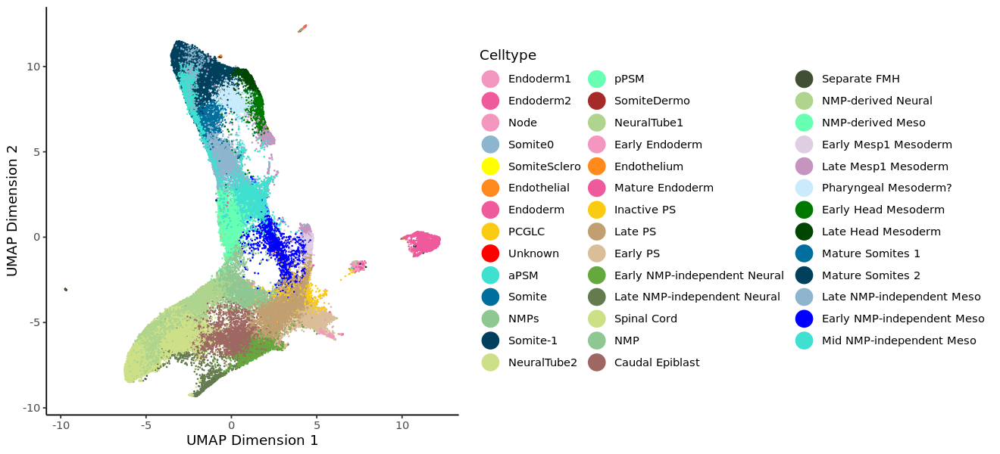

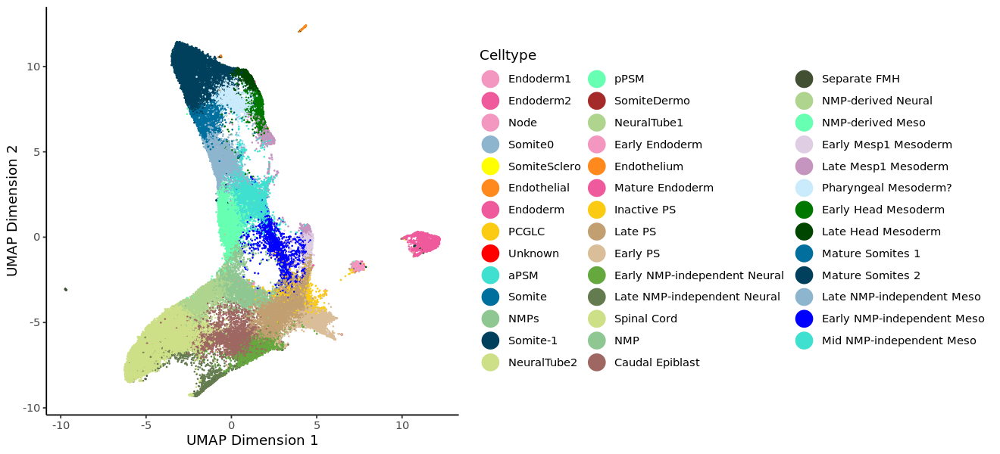

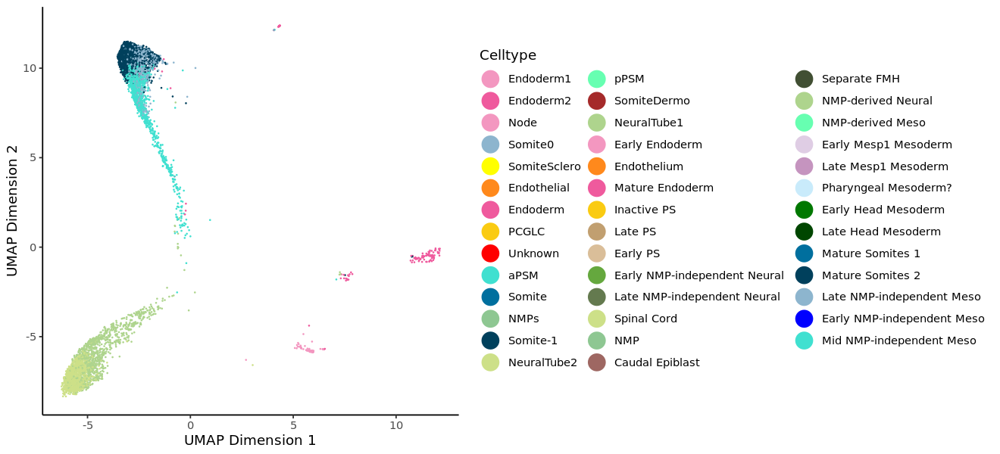

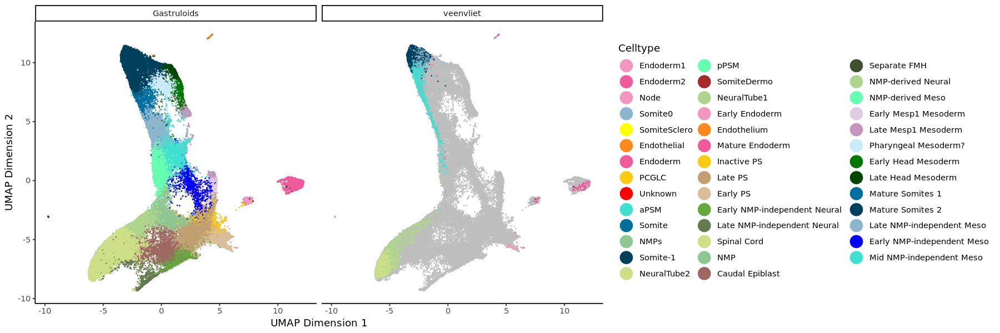

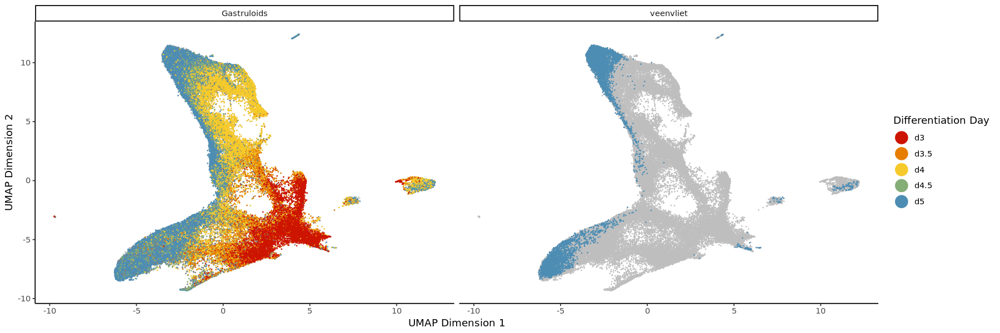

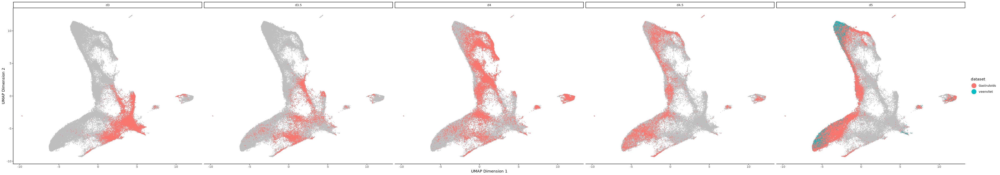

In [44]:
to.plot <- as.data.table(srat_gastr@meta.data)

options(repr.plot.width=6, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=dataset)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=11, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='Gastruloids'], mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='veenvliet'], mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=celltype_merge)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=timepoint)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = timepoint_colours, name = "Differentiation Day") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=40, repr.plot.height=7)
to.plot_shuffle <- to.plot[sample(nrow(to.plot)),]
to.plot_shuffle$timepoint <- factor(to.plot_shuffle$timepoint, levels=timepoint_order)
p <- ggplot(data=to.plot_shuffle[timepoint %in% timepoint_order], mapping = aes(x=X1_gastrInt, y=X2_gastrInt, colour=dataset)) +
  geom_point(data=select(to.plot_shuffle,-timepoint), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ timepoint, nrow=1)
print(p)

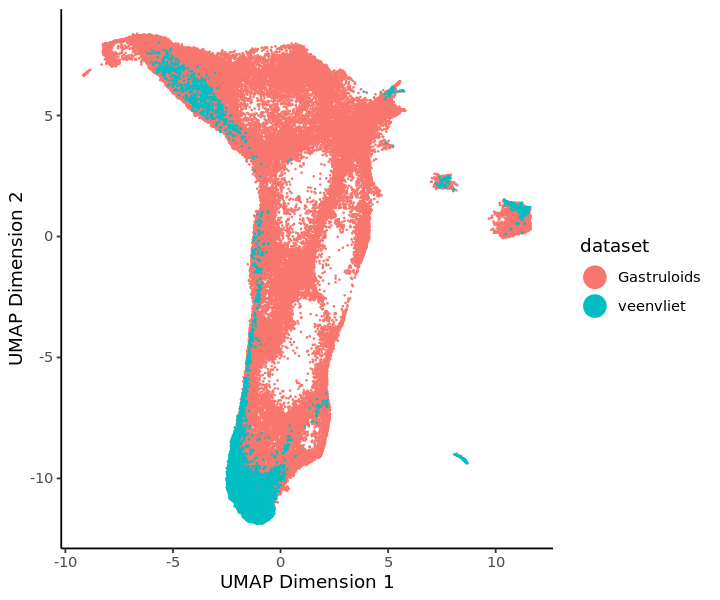

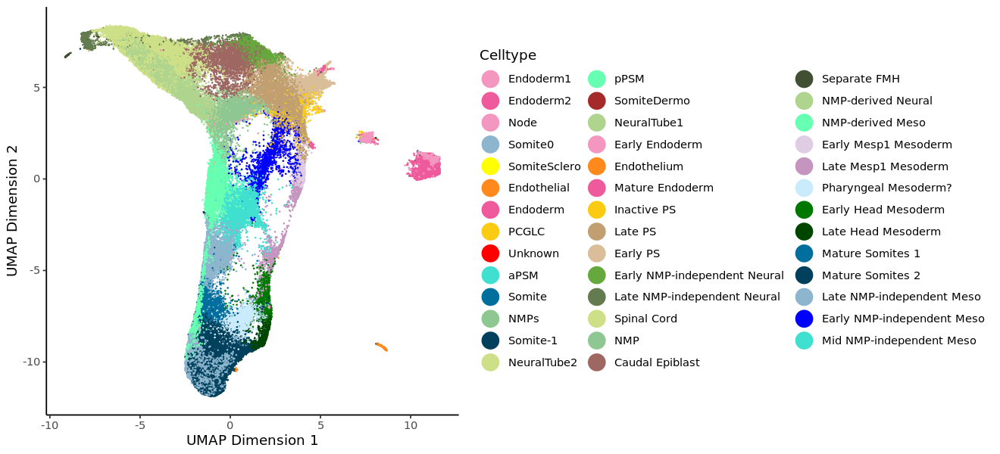

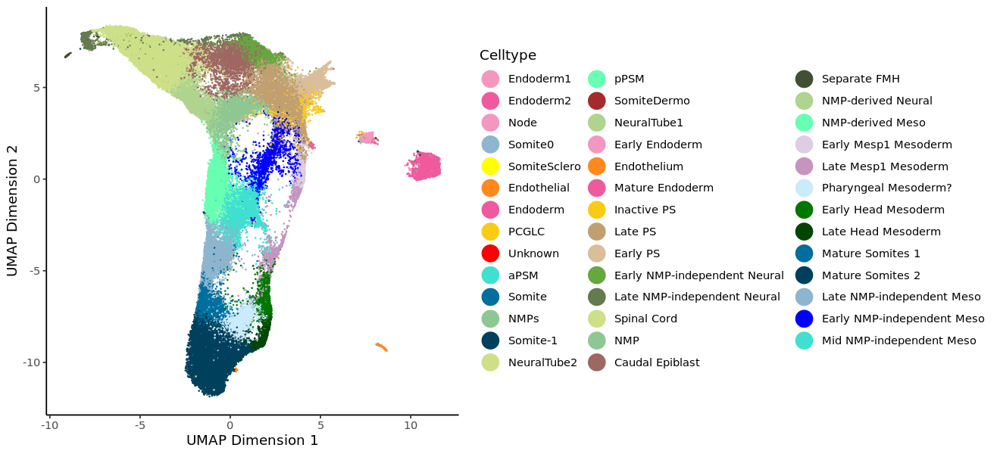

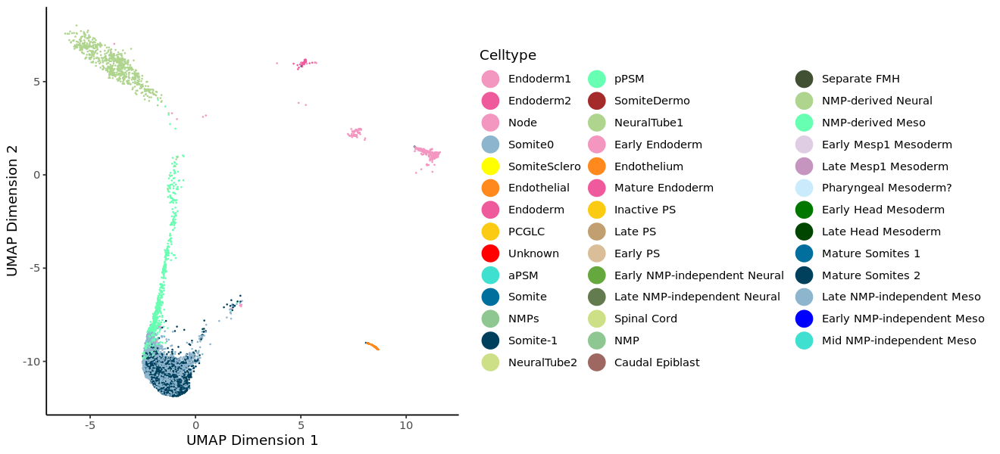

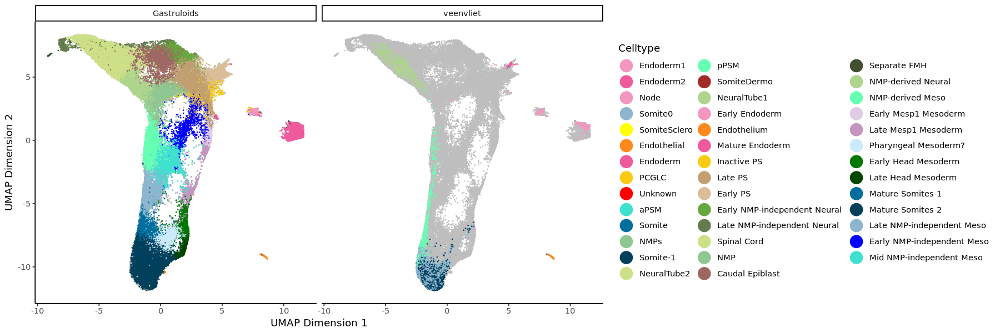

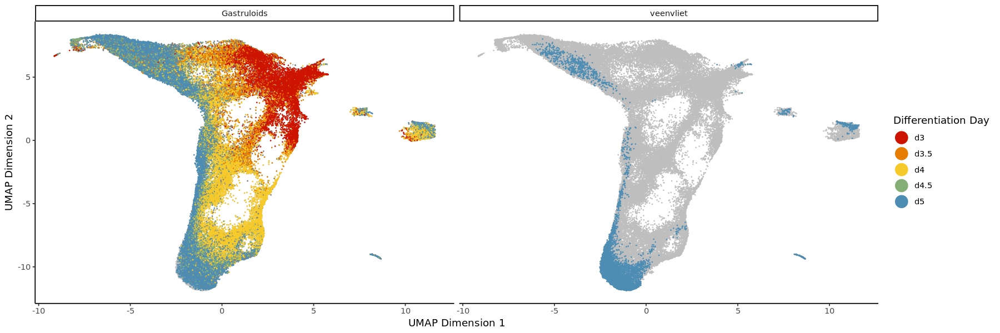

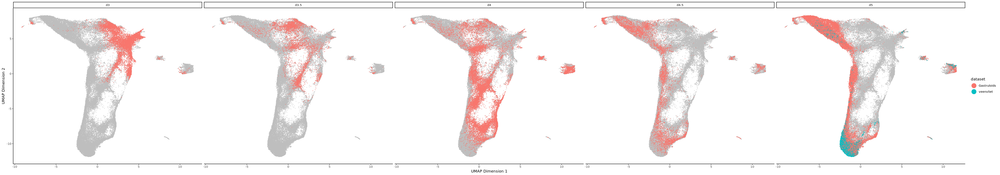

In [45]:
to.plot <- as.data.table(srat_TLSCL@meta.data)

options(repr.plot.width=6, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=dataset)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=11, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=cluster)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='Gastruloids'], mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

p <- ggplot(data=to.plot[dataset=='veenvliet'], mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=celltype_merge)) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=io$dot_size, alpha=io$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic()
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=celltype_merge)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = cluster_colours, name = "Celltype") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=15, repr.plot.height=5)
p <- ggplot(data=to.plot, mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=timepoint)) +
  geom_point(data=select(to.plot,-dataset), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  scale_colour_manual(values = timepoint_colours, name = "Differentiation Day") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ dataset, nrow=1)
print(p)

options(repr.plot.width=40, repr.plot.height=7)
to.plot_shuffle <- to.plot[sample(nrow(to.plot)),]
to.plot_shuffle$timepoint <- factor(to.plot_shuffle$timepoint, levels=timepoint_order)
p <- ggplot(data=to.plot_shuffle[timepoint %in% timepoint_order], mapping = aes(x=X1_TLSCLInt, y=X2_TLSCLInt, colour=dataset)) +
  geom_point(data=select(to.plot_shuffle,-timepoint), colour="grey", size=0.1, alpha=1) +
  geom_point(size=0.1, alpha=1) +
  # ggrastr::geom_point_rast(size=opts$dot_size, alpha=opts$dot_alpha) +
  labs(x="UMAP Dimension 1", y="UMAP Dimension 2") +
  guides(colour = guide_legend(override.aes = list(size=6))) +
  theme_classic() +
  facet_wrap(~ timepoint, nrow=1)
print(p)